#  Style Transfer using CycleGAN for MRI Images

In [ ]:
!nvidia-smi

Tue Dec  5 01:20:08 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8    11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

The dataset used is a sample data(provided) and dataset prepared from BraTS2020 Dataset.
Kaggle Link:https://www.kaggle.com/datasets/awsaf49/brats20-dataset-training-validation/code

### Importing Libraries

In [ ]:
pip install keras

In [ ]:
pip install tensorflow_addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 10.8 MB/s eta 0:00:00


In [ ]:
# Library for image processing and visualization
from skimage.transform import resize
from PIL import Image
import imageio
import matplotlib.pyplot as plt
%matplotlib inline

# Library for handling file operations
import os

# Library for handling array operations
import numpy as np

# Library for handling deep learning
import tensorflow as tf
from keras.utils import plot_model
import tensorflow_addons as tfa
autotune = tf.data.AUTOTUNE

# Library for Miscellaneous tasks
import warnings

warnings.filterwarnings("ignore")

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


### Data loading and preprocessing

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Path for images in Sample dataset provided
t1="/content/drive/MyDrive/MRI Dataset/Tr1/TrainT1"
t2="/content/drive/MyDrive/MRI Dataset/Tr2/TrainT2"

In [ ]:
# Image size
img_height = 128
img_width = 128

In [ ]:
# list of images
t1_images = [t1 + i for i in os.listdir(t1)]
t2_images = [t2 + i for i in os.listdir(t2)]

In [ ]:
# Creating lists of full file paths for T1 and T2 images
#t1_images = [os.path.join(t1, i) for i in os.listdir(t1)]
#t2_images = [os.path.join(t2, i) for i in os.listdir(t2)]

In [ ]:
# Images count for each category
print("\n\nTotal Images in each category:\n")
print(f"t1: {len(t1_images)}")
print(f"t2: {len(t2_images)}")



Total Images in each category:

t1: 44
t2: 47


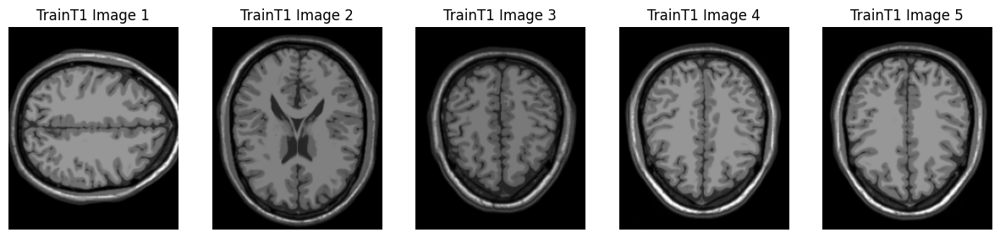

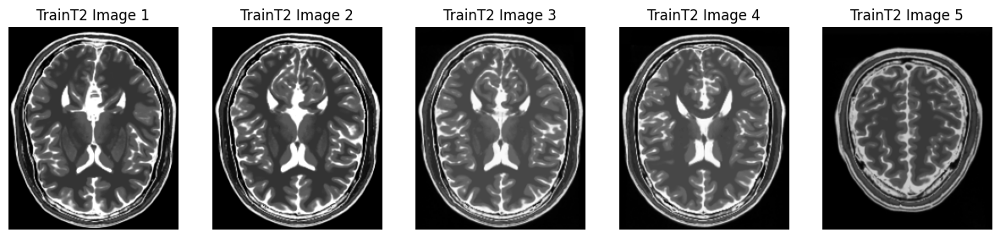

In [ ]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

# Function to randomly select a specified number of images from a directory
def get_random_images(directory, num_images):
    image_files = []
    for root, _, files in os.walk(directory):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.tiff')):
                image_files.append(os.path.join(root, file))
    return random.sample(image_files, min(num_images, len(image_files)))

# Function to display images
def display_images(image_paths, title):
    plt.figure(figsize=(15, 10))
    for i, image_path in enumerate(image_paths):
        img = Image.open(image_path)
        plt.subplot(1, len(image_paths), i + 1)
        plt.imshow(img, cmap='gray')
        plt.title(f'{title} {i+1}')
        plt.axis('off')
    plt.show()


# Number of images to display
num_images_to_display = 5

# Getting random images from TrainT1 and TrainT2
random_images_t1 = get_random_images(t1, num_images_to_display)
random_images_t2 = get_random_images(t2, num_images_to_display)

# Displaying the images
display_images(random_images_t1, 'TrainT1 Image')
display_images(random_images_t2, 'TrainT2 Image')

In [ ]:
import os
from PIL import Image, ImageEnhance, ImageOps

def augment_and_save_image(image_path, save_dir):
    with Image.open(image_path) as img:

        # File name without extension
        file_name = os.path.splitext(os.path.basename(image_path))[0]

        # Horizontal flip
        h_flip = ImageOps.mirror(img)
        h_flip.save(os.path.join(save_dir, file_name + '_hflip.png'))

        # Vertical flip
        v_flip = ImageOps.flip(img)
        v_flip.save(os.path.join(save_dir, file_name + '_vflip.png'))

        # Rotating image by 90 degrees
        rotated_img = img.rotate(90)
        rotated_img.save(os.path.join(save_dir, file_name + '_rotated.png'))

        # Decreasing brightness
        brightness_enhancer = ImageEnhance.Brightness(img)
        darker_img = brightness_enhancer.enhance(0.8)  # Decrease brightness by 20%
        darker_img.save(os.path.join(save_dir, file_name + '_darker.png'))

        # Adjusting contrast
        contrast_enhancer = ImageEnhance.Contrast(img)
        contrast_img = contrast_enhancer.enhance(1)  # Increase contrast
        contrast_img.save(os.path.join(save_dir, file_name + '_contrast.png'))

        # Enhancing shadows
        shadow_enhancer = ImageEnhance.Brightness(img)
        shadow_img = shadow_enhancer.enhance(0.8)  # Decrease brightness slightly to enhance shadows
        shadow_img.save(os.path.join(save_dir, file_name + '_shadow.png'))

        # Combined brightness and contrast adjustment
        brightness_enhancer = ImageEnhance.Brightness(img)
        adjusted_brightness = brightness_enhancer.enhance(0.8)  # Decrease brightness

        contrast_enhancer = ImageEnhance.Contrast(adjusted_brightness)
        combined_adjustment = contrast_enhancer.enhance(1.5)  # Increase contrast

        combined_adjustment.save(os.path.join(save_dir, file_name + '_combined_adj.png'))


# Directories to save augmented images
augmented_t1_dir = "/content/drive/MyDrive/MRI Dataset/Tr1/TrainT1/Augmented"
augmented_t2_dir = "/content/drive/MyDrive/MRI Dataset/Tr2/TrainT2/Augmented"

# Create directories if they don't exist
os.makedirs(augmented_t1_dir, exist_ok=True)
os.makedirs(augmented_t2_dir, exist_ok=True)

# Function to check if the path is an image
def is_image_file(file_name):
    return file_name.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif', '.tiff'))

# Process and save augmented images for t1 and t2 datasets
for image_file in os.listdir(t1):
    image_path = os.path.join(t1, image_file)
    if is_image_file(image_path):
        augment_and_save_image(image_path, augmented_t1_dir)

for image_file in os.listdir(t2):
    image_path = os.path.join(t2, image_file)
    if is_image_file(image_path):
        augment_and_save_image(image_path, augmented_t2_dir)

print("Data augmentation complete.")

Data augmentation complete.


In [ ]:
# Path for images in Sample dataset provided
augmented_t1 ="/content/drive/MyDrive/MRI Dataset/Tr1/TrainT1/Augmented"
augmented_t2 ="/content/drive/MyDrive/MRI Dataset/Tr2/TrainT2/Augmented"

In [ ]:
# list of images
t1_images = [augmented_t1 + i for i in os.listdir(augmented_t1)]
t2_images = [augmented_t2 + i for i in os.listdir(augmented_t1)]

In [ ]:
# Creating lists of full file paths for T1 and T2 images
t1_images = [os.path.join(augmented_t1, i) for i in os.listdir(augmented_t1)]
t2_images = [os.path.join(augmented_t2, i) for i in os.listdir(augmented_t2)]

In [ ]:
# Images count for each category
print("\n\nTotal Images in each category:\n")
print(f"t1: {len(t1_images)}")
print(f"t2: {len(t2_images)}")



Total Images in each category:

t1: 301
t2: 322


In [ ]:
# function to load images and resize
def load_images(img_list):
    img_arr = []
    for img in img_list:
        img = Image.open(img)
        img_arr.append(np.array(img))
    return np.array(img_arr)

In [ ]:
t1_images = load_images(t1_images)
t2_images = load_images(t2_images)

In [ ]:

# information of dataset
print("\n\nInformation of dataset:\n")
print(f"t1: {t1_images.shape}")
print(f"t2: {t2_images.shape}")



Information of dataset:

t1: (301, 217, 181)
t2: (322, 217, 181)


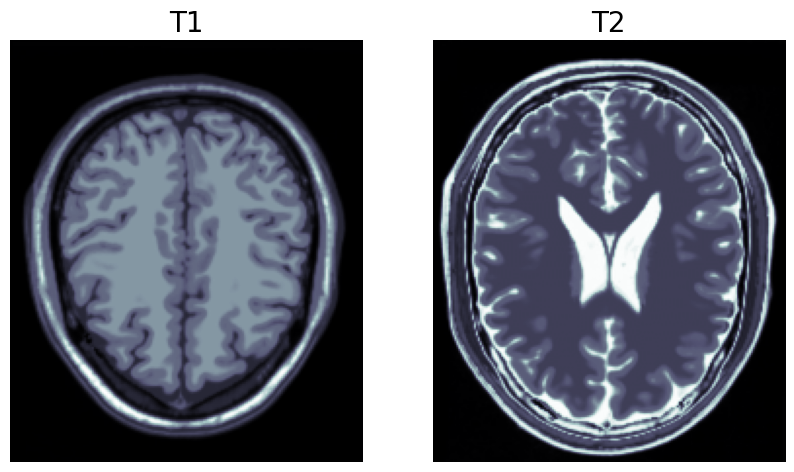

In [ ]:
# Printing sample images from each category after preprocessing
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(t1_images[0], cmap="bone")
plt.title("T1", fontsize=20)
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(t2_images[0], cmap="bone")
plt.title("T2", fontsize=20)
plt.axis("off")
plt.show()

In [ ]:
# Function to normalize images
def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    return (img / 127.5) - 1.0

In [ ]:
# Function to preprocess images
def preprocess_images(img):
    img = tf.image.random_flip_left_right(img)
    img = tf.image.resize(img, [*(img_height, img_width)])
    img = tf.image.random_crop(img, size=[*(img_height, img_width, 1)])
    img = normalize_img(img)
    return img

In [ ]:
# reshaping array to format (height, width, channels) with channels = 1
t1_images = t1_images.reshape(
    t1_images.shape[0], t1_images.shape[1], t1_images.shape[2], 1
).astype("float32")
t2_images = t2_images.reshape(
    t2_images.shape[0], t2_images.shape[1], t2_images.shape[2], 1
).astype("float32")

In [ ]:
# Daataset augmentation
data_augmentation = tf.keras.Sequential([tf.keras.layers.RandomFlip("horizontal")])
t1_images = np.concatenate([data_augmentation(t1_images), t1_images], axis=0)
t2_images = np.concatenate([data_augmentation(t2_images), t2_images], axis=0)

In [ ]:
t1_images = [preprocess_images(image) for image in t1_images]
t2_images = [preprocess_images(image) for image in t2_images]

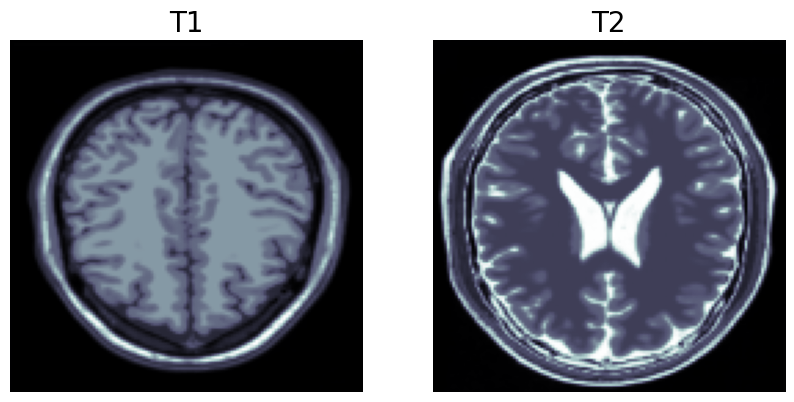

In [ ]:
# Printing sample images from each category after preprocessing
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(t1_images[0], cmap="bone")
plt.title("T1", fontsize=20)
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(t2_images[0], cmap="bone")
plt.title("T2", fontsize=20)
plt.axis("off")
plt.show()

### Data Batch Creation

In [ ]:
# defining batch and buffer size
buffer_size = 256
batch_size = 1

In [ ]:
import tensorflow as tf
import numpy as np

# Function to split dataset into train, validation, and test sets
def split_dataset(images, train_frac=0.7, val_frac=0.15, test_frac=0.15):
    assert train_frac + val_frac + test_frac == 1

    # Shuffling the dataset
    np.random.shuffle(images)

    total_images = len(images)
    train_size = int(train_frac * total_images)
    val_size = int(val_frac * total_images)

    # Split the dataset
    train_images = images[:train_size]
    val_images = images[train_size:train_size + val_size]
    test_images = images[train_size + val_size:]

    return train_images, val_images, test_images

# Splitting the datasets
t1_train, t1_val, t1_test = split_dataset(t1_images)
t2_train, t2_val, t2_test = split_dataset(t2_images)

# Buffer and Batch Size
buffer_size = 256  # Or use len(t1_train) for full dataset shuffling
batch_size = 1

# Preparing TensorFlow Dataset objects
train_t1_images = (
    tf.data.Dataset.from_tensor_slices(t1_train)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
train_t2_images = (
    tf.data.Dataset.from_tensor_slices(t2_train)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

test_t1_images = (
    tf.data.Dataset.from_tensor_slices(t1_test)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
test_t2_images = (
    tf.data.Dataset.from_tensor_slices(t2_test)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

val_t1_images = (
    tf.data.Dataset.from_tensor_slices(t1_val)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
val_t2_images = (
    tf.data.Dataset.from_tensor_slices(t2_val)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

In [ ]:
t1_images = (
    tf.data.Dataset.from_tensor_slices(t1_images)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
t2_images = (
    tf.data.Dataset.from_tensor_slices(t2_images)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

### Creating Generator and Discriminator

In [ ]:
# Weights initializer for the layers.
kernel_init = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

In [ ]:
# Downsampling method
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0.0, 0.02)
    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(
            filters,
            size,
            strides=2,
            padding="same",
            kernel_initializer=initializer,
            use_bias=False,
        )
    )
    if apply_norm:
        result.add(tfa.layers.InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

In [ ]:
# Upsampling method
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0.0, 0.02)
    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2DTranspose(
            filters,
            size,
            strides=2,
            padding="same",
            kernel_initializer=initializer,
            use_bias=False,
        )
    )
    result.add(tfa.layers.InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result

In [ ]:
def unet_generator():
    down_stack = [
        downsample(128, 4, apply_norm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
    ]
    # create a stack of downsample models
    up_stack = [
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(128, 4),
    ]  # create a stack of upsample models

    initializer = tf.random_normal_initializer(0.0, 0.02)
    last = tf.keras.layers.Conv2DTranspose(
        1,
        4,
        strides=2,
        padding="same",
        kernel_initializer=initializer,
        activation="tanh",
    )
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [ ]:
# Creating generator models
generator_g = unet_generator()
generator_f = unet_generator()

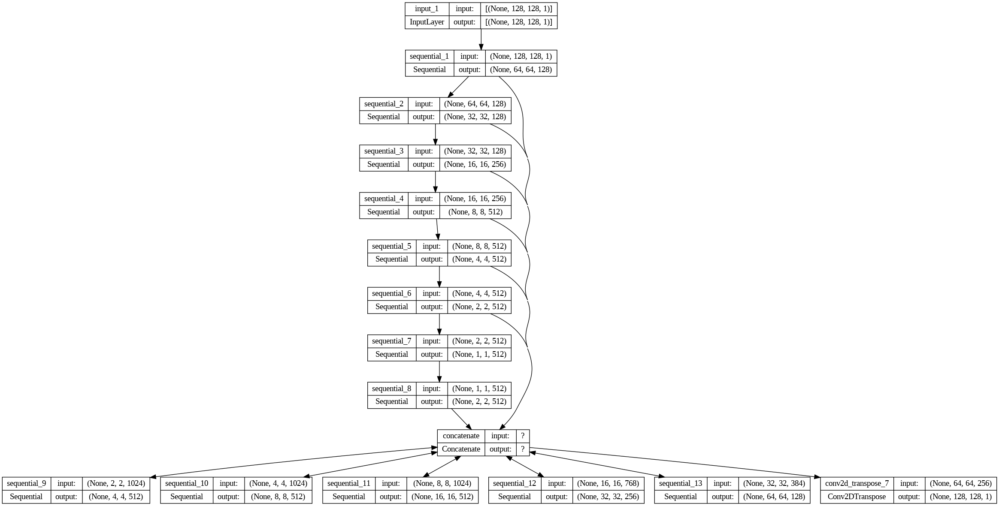

In [ ]:
# Printing summary of generator g
plot_model(generator_g, show_shapes=True)

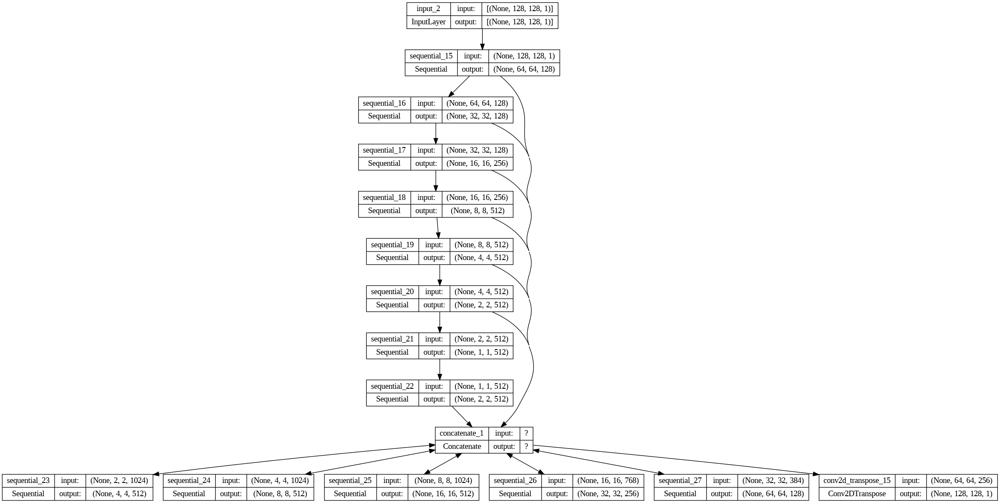

In [ ]:
# Printing summary of generator f
plot_model(generator_f, show_shapes=True)

In [ ]:
# function for discriminator
def discriminator():
    in_image = tf.keras.layers.Input(shape=[128, 128, 1], name="input_image")
    d = tf.keras.layers.Conv2D(
        64, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(in_image)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        128, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(d)
    d = tfa.layers.InstanceNormalization(axis=-1)(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        256, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(d)
    d = tfa.layers.InstanceNormalization(axis=-1)(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        512, (4, 4), strides=(2, 2), padding="same", kernel_initializer=kernel_init
    )(d)
    d = tfa.layers.InstanceNormalization(axis=-1)(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    d = tf.keras.layers.Conv2D(
        512, (4, 4), padding="same", kernel_initializer=kernel_init
    )(d)
    d = tfa.layers.InstanceNormalization(axis=-1)(d)
    d = tf.keras.layers.LeakyReLU(alpha=0.2)(d)
    patch_out = tf.keras.layers.Conv2D(
        1, (4, 4), padding="same", kernel_initializer=kernel_init
    )(d)
    return tf.keras.models.Model(in_image, patch_out)

In [ ]:
# Creating generator models
discriminator_x = discriminator()
discriminator_y = discriminator()

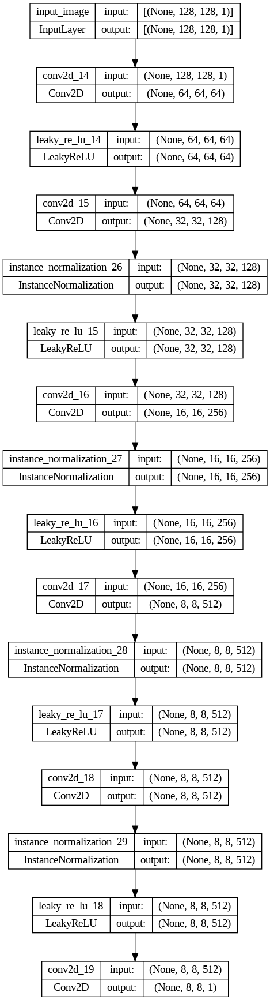

In [ ]:
# Printing summary of generator g
plot_model(discriminator_x, show_shapes=True)

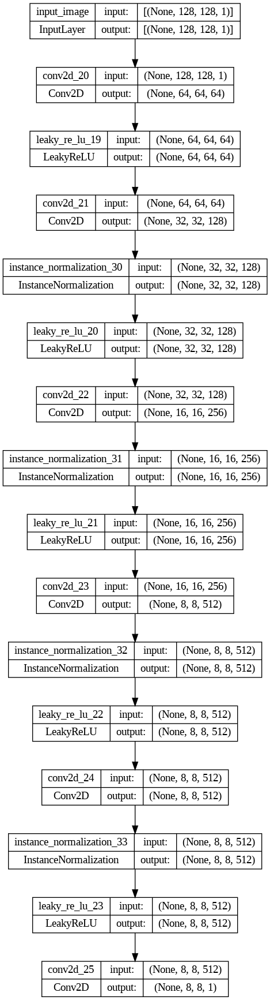

In [ ]:
# Printing summary of generator f
plot_model(discriminator_y, show_shapes=True)

### Defining Loss Functions

In [ ]:
# Binary cross entropy loss function
bce_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
# Define the loss function for the generators
def generator_loss(generated):
    return bce_loss(tf.ones_like(generated), generated)

In [ ]:
# function for discriminator loss
def discriminator_loss(real, generated):
    real_loss = bce_loss(tf.ones_like(real), real)
    generated_loss = bce_loss(tf.zeros_like(generated), generated)
    return (real_loss + generated_loss) * 0.5

In [ ]:
# Cycle consistency loss function
def calc_cycle_loss(real_image, cycled_image):
    return tf.reduce_mean(tf.abs(real_image - cycled_image))

In [ ]:
# Identity loss function
def identity_loss(real_image, same_image):
    return tf.reduce_mean(tf.abs(real_image - same_image))

Parameters for Loss Function defined in CycleGAN Model class (10,0.5)

### Defining Optimizers

In [ ]:
# Leveraging Adam Optimizer to smoothen gradient descent
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

### CycleGAN Model

In [ ]:
class CycleGan(tf.keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super().__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def call(self, inputs):
        return (
            self.disc_X(inputs),
            self.disc_Y(inputs),
            self.gen_G(inputs),
            self.gen_F(inputs),
        )

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
        cycle_loss_fn,
        identity_loss_fn,
    ):
        super().compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = calc_cycle_loss
        self.identity_loss_fn = identity_loss_fn

    def train_step(self, batch_data):
        real_x, real_y = batch_data
        with tf.GradientTape(persistent=True) as tape:
            fake_y = self.gen_G(real_x, training=True)
            fake_x = self.gen_F(real_y, training=True)

            cycled_x = self.gen_F(fake_y, training=True)
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adversarial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
            "Total_Generator_Loss": total_loss_G+total_loss_F,
        }

### CallBacks defined

In [ ]:
# Getting Sample Image
t1_sample = train_t1_images.shuffle(buffer_size).as_numpy_iterator().next()
t2_sample = train_t2_images.shuffle(buffer_size).as_numpy_iterator().next()

class GANMonitor(tf.keras.callbacks.Callback):
    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_train_begin(self, epoch, logs=None):
        prediction1 = self.model.gen_G.predict(t1_sample)
        prediction2 = self.model.gen_F.predict(t2_sample)
        fig = plt.figure(figsize=(8, 4))
        display_list = [t1_sample[0], prediction1[0], t2_sample[0], prediction2[0]]
        title = ["Input Image T1", "Generated Image T1", "Input Image T1", "Generated Image T2"]
        for i in range(4):
            plt.subplot(1, 4, i + 1)
            plt.title(title[i])
            plt.imshow(display_list[i][:, :, 0], cmap="gray")
            plt.axis("off")
        fig.suptitle("CycleGAN Sample Output Before Training", fontsize=16)
        plt.savefig("/content/drive/MyDrive/MRI Dataset/Image Epochs/image_at_epoch_0.png")
        plt.show()
        plt.close()

    def on_epoch_end(self, epoch, logs=None):
        prediction1 = self.model.gen_G.predict(t1_sample)
        prediction2 = self.model.gen_F.predict(t2_sample)
        fig = plt.figure(figsize=(8, 4))
        display_list = [t1_sample[0], prediction1[0], t2_sample[0], prediction2[0]]
        title = ["Input Image T1", "Generated Image T1", "Input Image T2", "Generated Image T2"]
        for i in range(4):
            plt.subplot(1, 4, i + 1)
            plt.title(title[i])
            plt.imshow(display_list[i][:, :, 0], cmap="gray")
            plt.axis("off")
        fig.suptitle(f"CycleGAN Sample Output After epoch {epoch+1}", fontsize=16)
        plt.savefig(f"/content/drive/MyDrive/MRI Dataset/Image Epochs/image_at_epoch_{epoch+1}.png")
        plt.show()
        plt.close()

In [ ]:
# Checkpoint callback
checkpoint_filepath = (
    "/content/drive/MyDrive/MRI Dataset/CycleGAN_Checkpoints/cyclegan_checkpoints.{epoch:03d}"
)
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    monitor="Total_Generator_Loss",filepath=checkpoint_filepath, save_weights_only=True, save_freq="epoch",save_best_only=True
)

### Model Training

In [ ]:
# Defining epochs
epochs = 150

In [ ]:
# create a CycleGAN model
cycle_gan_model = CycleGan(
    generator_F=generator_f,
    generator_G=generator_g,
    discriminator_X=discriminator_x,
    discriminator_Y=discriminator_y,
)

In [ ]:
# compile the model
cycle_gan_model.compile(
    gen_G_optimizer=generator_g_optimizer,
    gen_F_optimizer=generator_f_optimizer,
    disc_X_optimizer=discriminator_x_optimizer,
    disc_Y_optimizer=discriminator_y_optimizer,
    gen_loss_fn=generator_loss,
    disc_loss_fn=discriminator_loss,
    cycle_loss_fn=calc_cycle_loss,
    identity_loss_fn=identity_loss,
)

In [ ]:
# Callbacks
plotter = GANMonitor()

1/1 [==============================] - 0s 22ms/step


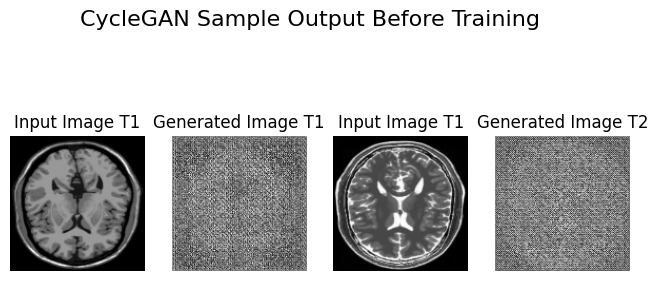

Epoch 1/150
1/1 [==============================] - 0s 22ms/step


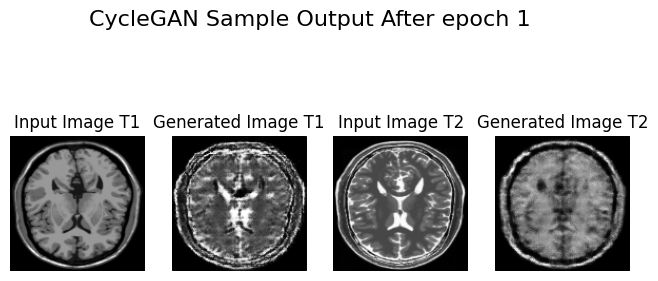

421/421 [==============================] - 87s 154ms/step - G_loss: 4.0282 - F_loss: 2.9909 - D_X_loss: 0.6400 - D_Y_loss: 0.5826 - Total_Generator_Loss: 7.0191
Epoch 2/150
1/1 [==============================] - 0s 20ms/step


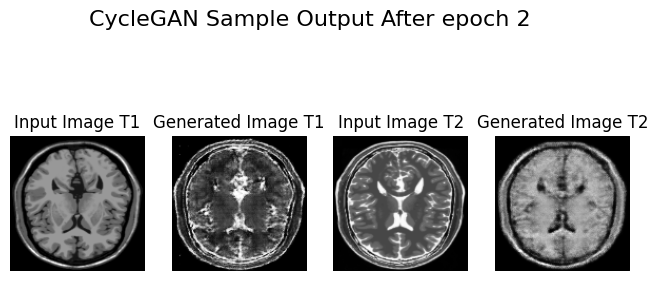

421/421 [==============================] - 65s 154ms/step - G_loss: 3.6232 - F_loss: 2.6437 - D_X_loss: 0.6074 - D_Y_loss: 0.5262 - Total_Generator_Loss: 6.2668
Epoch 3/150
1/1 [==============================] - 0s 21ms/step


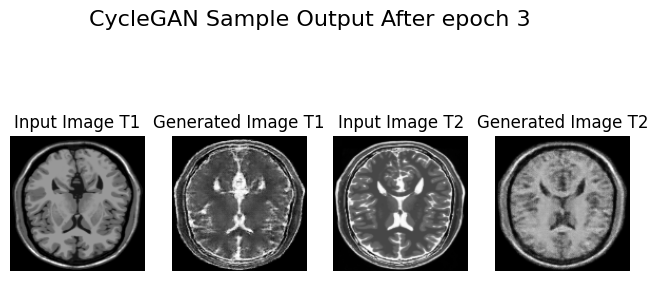

421/421 [==============================] - 65s 154ms/step - G_loss: 3.2543 - F_loss: 2.3106 - D_X_loss: 0.6281 - D_Y_loss: 0.5288 - Total_Generator_Loss: 5.5649
Epoch 4/150
1/1 [==============================] - 0s 20ms/step


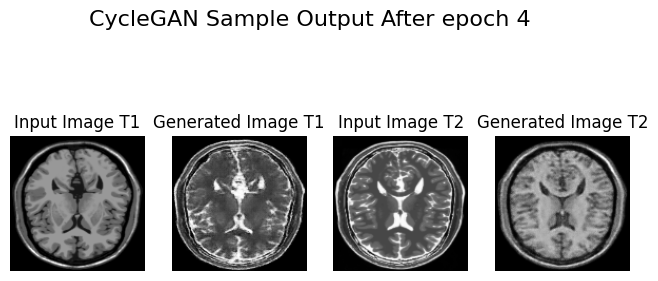

421/421 [==============================] - 65s 154ms/step - G_loss: 2.6877 - F_loss: 1.8763 - D_X_loss: 0.6760 - D_Y_loss: 0.5928 - Total_Generator_Loss: 4.5639
Epoch 5/150
1/1 [==============================] - 0s 21ms/step


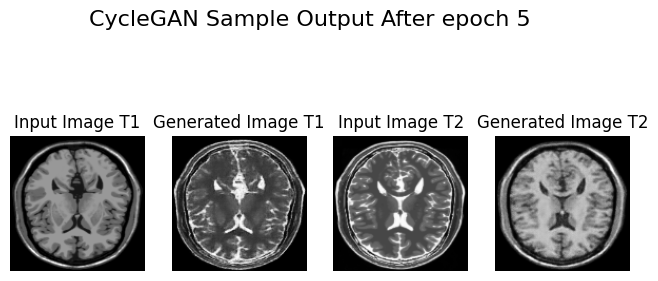

421/421 [==============================] - 65s 154ms/step - G_loss: 2.2508 - F_loss: 1.5909 - D_X_loss: 0.6776 - D_Y_loss: 0.6121 - Total_Generator_Loss: 3.8417
Epoch 6/150
1/1 [==============================] - 0s 20ms/step


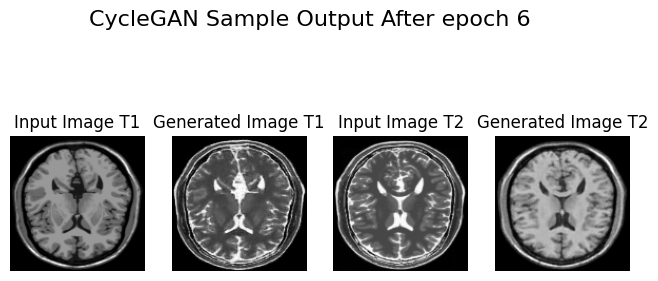

421/421 [==============================] - 65s 154ms/step - G_loss: 1.9389 - F_loss: 1.3966 - D_X_loss: 0.6965 - D_Y_loss: 0.6512 - Total_Generator_Loss: 3.3355
Epoch 7/150
1/1 [==============================] - 0s 22ms/step


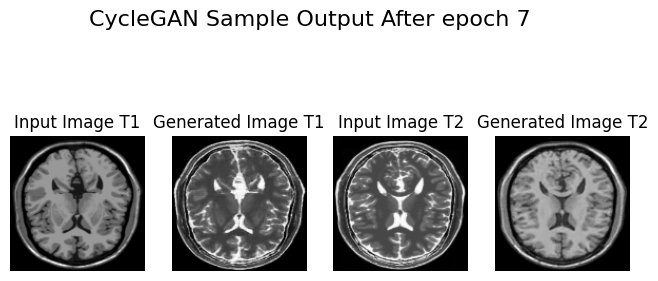

421/421 [==============================] - 65s 154ms/step - G_loss: 1.7983 - F_loss: 1.2864 - D_X_loss: 0.6945 - D_Y_loss: 0.6509 - Total_Generator_Loss: 3.0847
Epoch 8/150
1/1 [==============================] - 0s 21ms/step


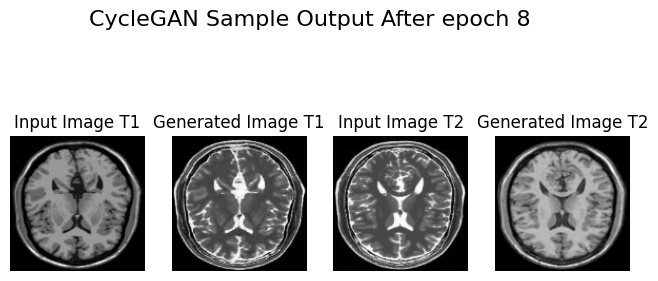

421/421 [==============================] - 65s 154ms/step - G_loss: 1.7162 - F_loss: 1.2458 - D_X_loss: 0.6938 - D_Y_loss: 0.6552 - Total_Generator_Loss: 2.9619
Epoch 9/150
1/1 [==============================] - 0s 20ms/step


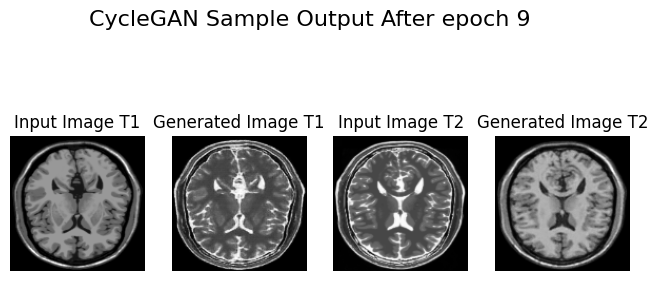

421/421 [==============================] - 65s 154ms/step - G_loss: 1.6230 - F_loss: 1.1951 - D_X_loss: 0.6939 - D_Y_loss: 0.6605 - Total_Generator_Loss: 2.8181
Epoch 10/150
1/1 [==============================] - 0s 22ms/step


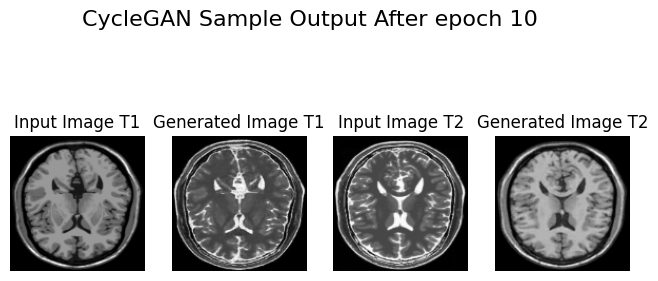

421/421 [==============================] - 65s 154ms/step - G_loss: 1.5807 - F_loss: 1.1831 - D_X_loss: 0.6919 - D_Y_loss: 0.6625 - Total_Generator_Loss: 2.7638
Epoch 11/150
1/1 [==============================] - 0s 21ms/step


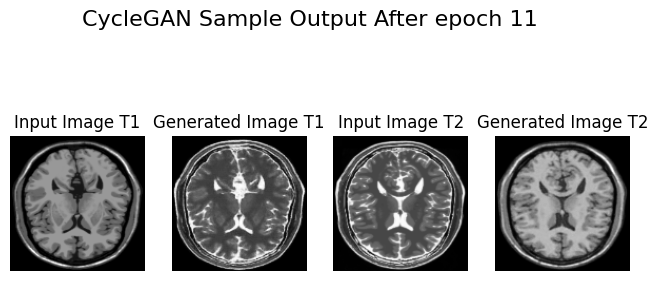

421/421 [==============================] - 65s 154ms/step - G_loss: 1.5586 - F_loss: 1.1615 - D_X_loss: 0.6935 - D_Y_loss: 0.6587 - Total_Generator_Loss: 2.7201
Epoch 12/150
1/1 [==============================] - 0s 21ms/step


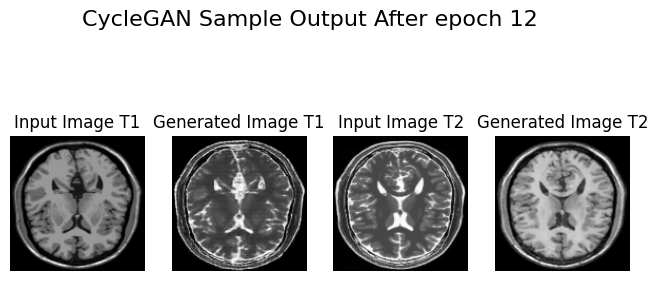

421/421 [==============================] - 65s 154ms/step - G_loss: 2.6174 - F_loss: 1.2325 - D_X_loss: 0.6876 - D_Y_loss: 0.4100 - Total_Generator_Loss: 3.8498
Epoch 13/150
1/1 [==============================] - 0s 20ms/step


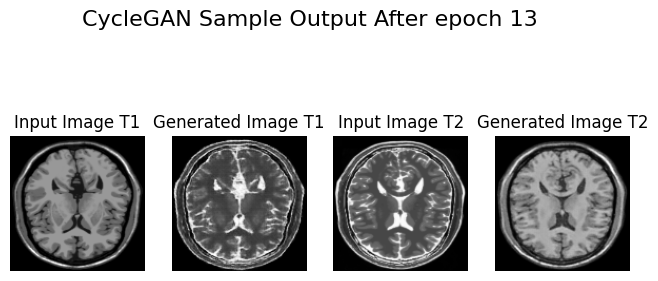

421/421 [==============================] - 65s 154ms/step - G_loss: 3.2769 - F_loss: 1.2228 - D_X_loss: 0.6903 - D_Y_loss: 0.3323 - Total_Generator_Loss: 4.4997
Epoch 14/150
1/1 [==============================] - 0s 21ms/step


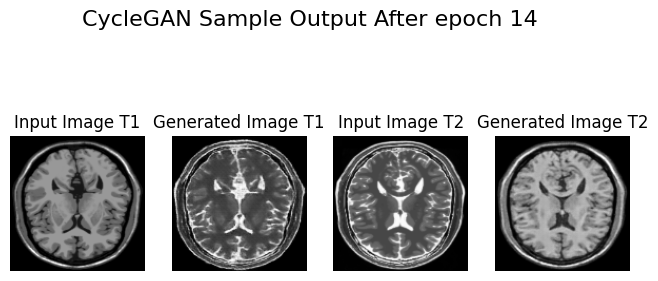

421/421 [==============================] - 65s 154ms/step - G_loss: 3.6735 - F_loss: 1.2542 - D_X_loss: 0.6871 - D_Y_loss: 0.2934 - Total_Generator_Loss: 4.9277
Epoch 15/150
1/1 [==============================] - 0s 20ms/step


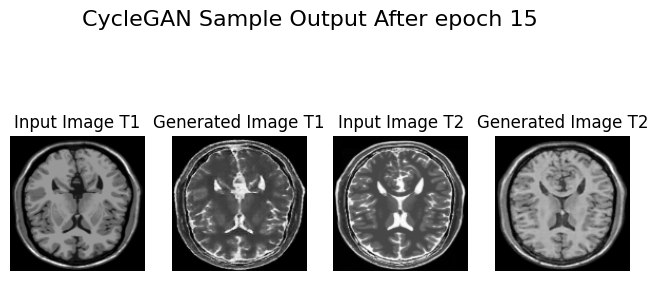

421/421 [==============================] - 65s 154ms/step - G_loss: 4.1657 - F_loss: 1.2105 - D_X_loss: 0.6840 - D_Y_loss: 0.2218 - Total_Generator_Loss: 5.3762
Epoch 16/150
1/1 [==============================] - 0s 21ms/step


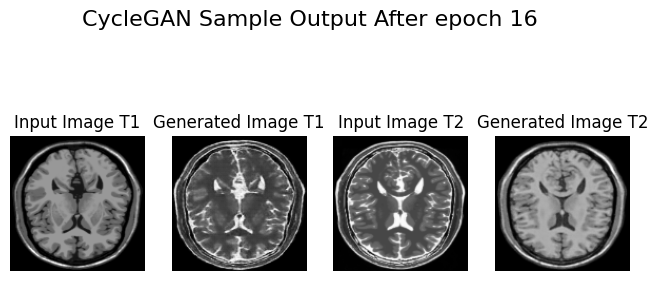

421/421 [==============================] - 65s 153ms/step - G_loss: 4.1164 - F_loss: 1.1351 - D_X_loss: 0.6945 - D_Y_loss: 0.2629 - Total_Generator_Loss: 5.2514
Epoch 17/150
1/1 [==============================] - 0s 21ms/step


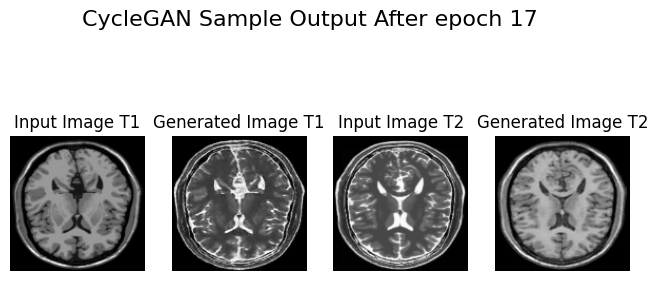

421/421 [==============================] - 65s 154ms/step - G_loss: 4.2048 - F_loss: 1.1236 - D_X_loss: 0.6897 - D_Y_loss: 0.2377 - Total_Generator_Loss: 5.3284
Epoch 18/150
1/1 [==============================] - 0s 21ms/step


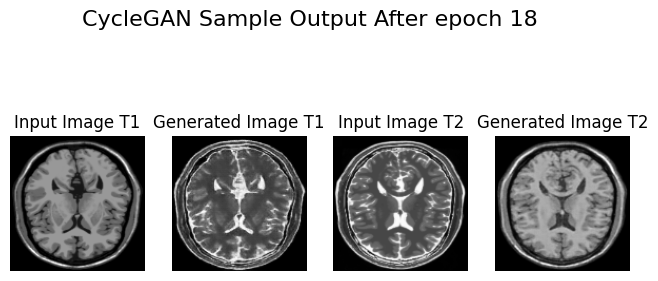

421/421 [==============================] - 65s 154ms/step - G_loss: 4.4124 - F_loss: 1.2458 - D_X_loss: 0.6781 - D_Y_loss: 0.2299 - Total_Generator_Loss: 5.6582
Epoch 19/150
1/1 [==============================] - 0s 21ms/step


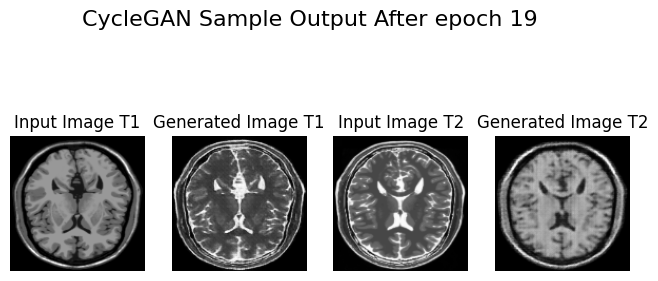

421/421 [==============================] - 65s 154ms/step - G_loss: 4.3098 - F_loss: 1.6826 - D_X_loss: 0.6004 - D_Y_loss: 0.2578 - Total_Generator_Loss: 5.9924
Epoch 20/150
1/1 [==============================] - 0s 22ms/step


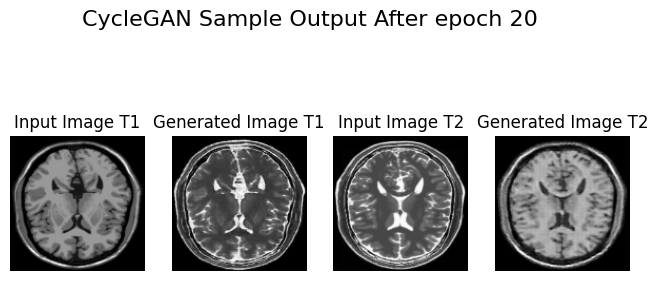

421/421 [==============================] - 65s 154ms/step - G_loss: 4.6155 - F_loss: 2.2221 - D_X_loss: 0.4882 - D_Y_loss: 0.2238 - Total_Generator_Loss: 6.8376
Epoch 21/150
1/1 [==============================] - 0s 21ms/step


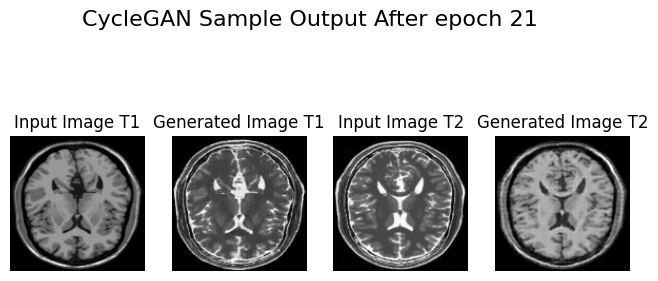

421/421 [==============================] - 65s 155ms/step - G_loss: 4.9218 - F_loss: 2.6136 - D_X_loss: 0.4039 - D_Y_loss: 0.2052 - Total_Generator_Loss: 7.5355
Epoch 22/150
1/1 [==============================] - 0s 22ms/step


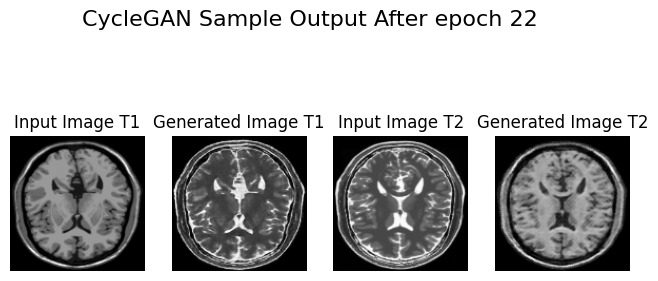

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1287 - F_loss: 3.4139 - D_X_loss: 0.2731 - D_Y_loss: 0.1884 - Total_Generator_Loss: 8.5426
Epoch 23/150
1/1 [==============================] - 0s 22ms/step


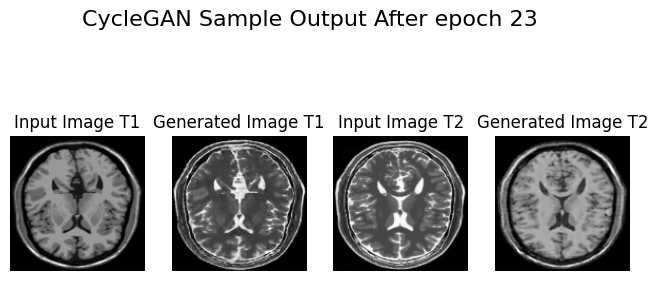

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1623 - F_loss: 3.2564 - D_X_loss: 0.3164 - D_Y_loss: 0.2173 - Total_Generator_Loss: 8.4187
Epoch 24/150
1/1 [==============================] - 0s 20ms/step


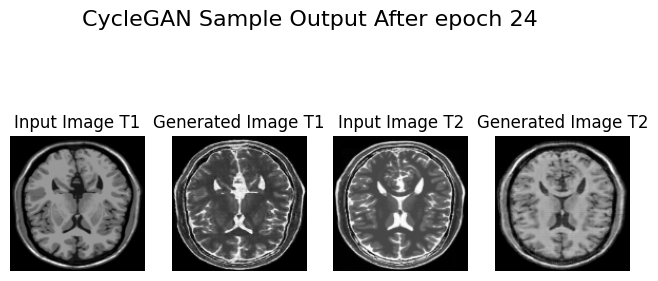

421/421 [==============================] - 65s 154ms/step - G_loss: 4.9392 - F_loss: 3.7242 - D_X_loss: 0.2512 - D_Y_loss: 0.2277 - Total_Generator_Loss: 8.6634
Epoch 25/150
1/1 [==============================] - 0s 22ms/step


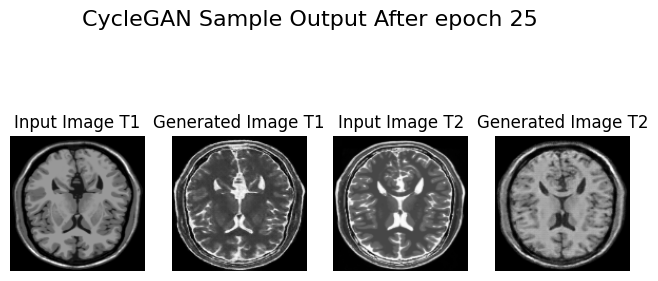

421/421 [==============================] - 65s 154ms/step - G_loss: 4.8570 - F_loss: 3.4334 - D_X_loss: 0.2970 - D_Y_loss: 0.2290 - Total_Generator_Loss: 8.2904
Epoch 26/150
1/1 [==============================] - 0s 23ms/step


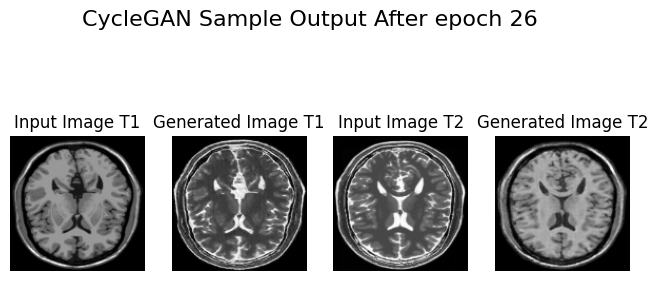

421/421 [==============================] - 65s 154ms/step - G_loss: 5.2761 - F_loss: 3.6287 - D_X_loss: 0.2821 - D_Y_loss: 0.1725 - Total_Generator_Loss: 8.9048
Epoch 27/150
1/1 [==============================] - 0s 23ms/step


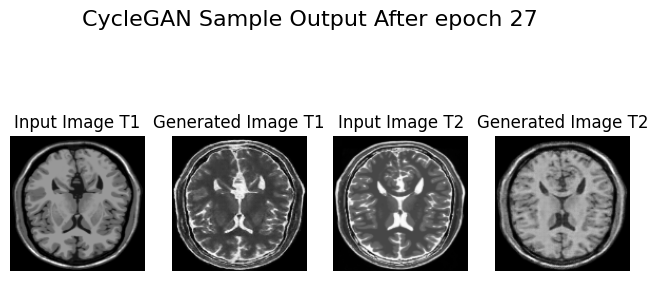

421/421 [==============================] - 65s 154ms/step - G_loss: 4.7958 - F_loss: 3.7825 - D_X_loss: 0.2536 - D_Y_loss: 0.2671 - Total_Generator_Loss: 8.5784
Epoch 28/150
1/1 [==============================] - 0s 22ms/step


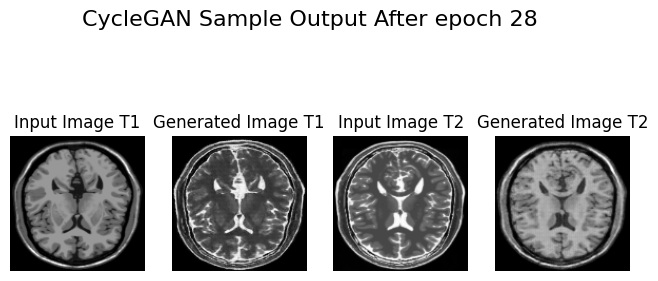

421/421 [==============================] - 65s 154ms/step - G_loss: 4.9362 - F_loss: 3.8758 - D_X_loss: 0.2358 - D_Y_loss: 0.2071 - Total_Generator_Loss: 8.8120
Epoch 29/150
1/1 [==============================] - 0s 22ms/step


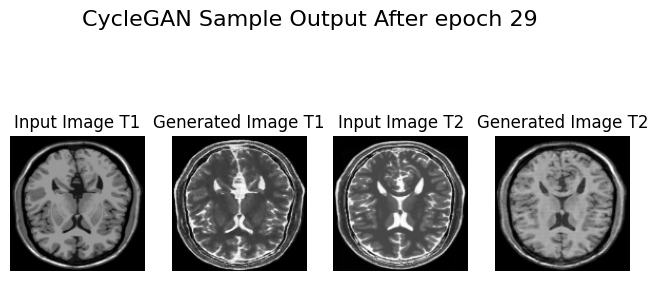

421/421 [==============================] - 65s 154ms/step - G_loss: 5.2561 - F_loss: 4.1361 - D_X_loss: 0.2233 - D_Y_loss: 0.1955 - Total_Generator_Loss: 9.3921
Epoch 30/150
1/1 [==============================] - 0s 20ms/step


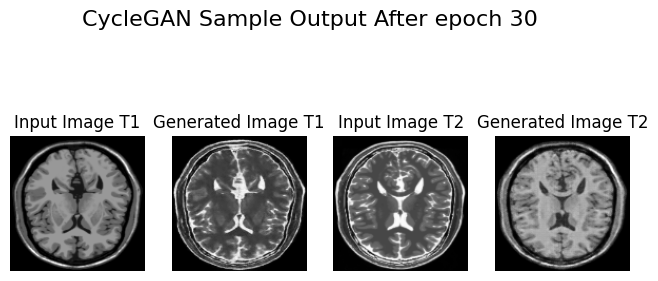

421/421 [==============================] - 65s 154ms/step - G_loss: 5.0939 - F_loss: 3.7570 - D_X_loss: 0.2717 - D_Y_loss: 0.2121 - Total_Generator_Loss: 8.8508
Epoch 31/150
1/1 [==============================] - 0s 20ms/step


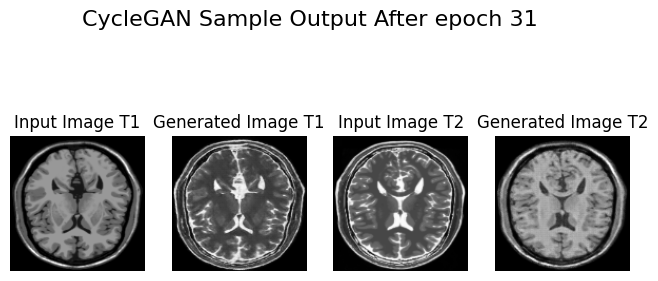

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1004 - F_loss: 4.2115 - D_X_loss: 0.2286 - D_Y_loss: 0.2162 - Total_Generator_Loss: 9.3119
Epoch 32/150
1/1 [==============================] - 0s 20ms/step


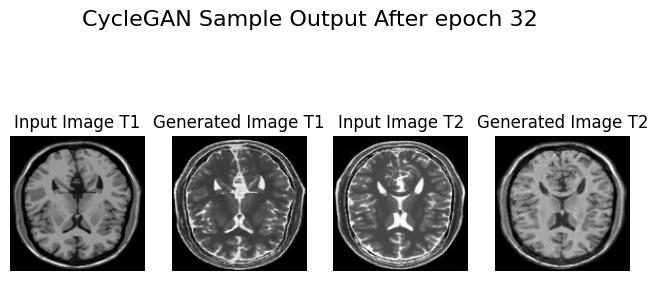

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1827 - F_loss: 4.3054 - D_X_loss: 0.2299 - D_Y_loss: 0.2129 - Total_Generator_Loss: 9.4882
Epoch 33/150
1/1 [==============================] - 0s 21ms/step


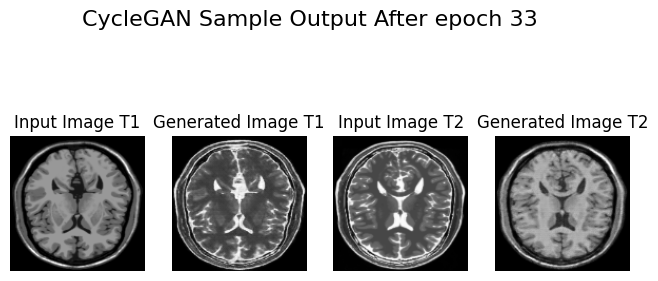

421/421 [==============================] - 65s 154ms/step - G_loss: 4.9825 - F_loss: 4.1672 - D_X_loss: 0.2452 - D_Y_loss: 0.2024 - Total_Generator_Loss: 9.1497
Epoch 34/150
1/1 [==============================] - 0s 20ms/step


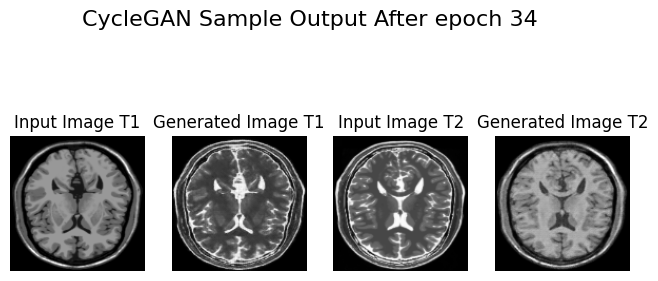

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1520 - F_loss: 4.3808 - D_X_loss: 0.2290 - D_Y_loss: 0.2043 - Total_Generator_Loss: 9.5328
Epoch 35/150
1/1 [==============================] - 0s 20ms/step


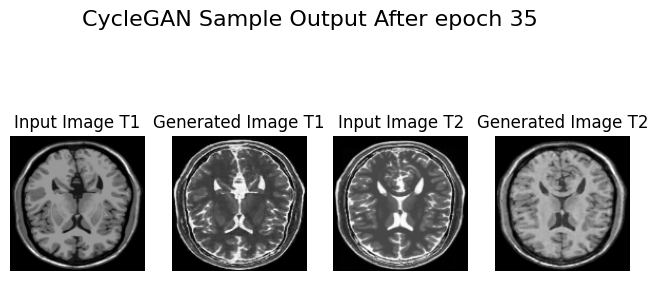

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1574 - F_loss: 4.4490 - D_X_loss: 0.2132 - D_Y_loss: 0.1930 - Total_Generator_Loss: 9.6063
Epoch 36/150
1/1 [==============================] - 0s 21ms/step


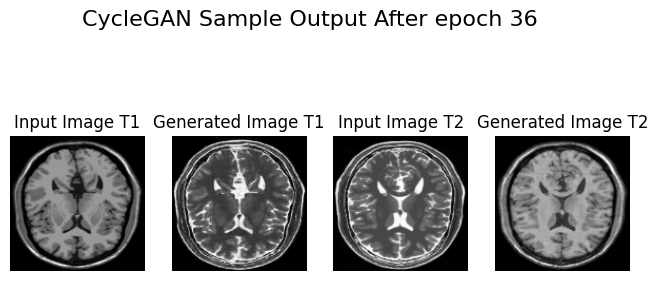

421/421 [==============================] - 65s 154ms/step - G_loss: 5.0021 - F_loss: 4.2962 - D_X_loss: 0.2326 - D_Y_loss: 0.2274 - Total_Generator_Loss: 9.2982
Epoch 37/150
1/1 [==============================] - 0s 21ms/step


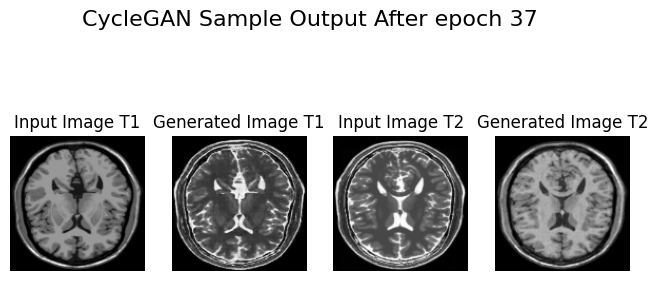

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1169 - F_loss: 4.2509 - D_X_loss: 0.2388 - D_Y_loss: 0.2063 - Total_Generator_Loss: 9.3679
Epoch 38/150
1/1 [==============================] - 0s 21ms/step


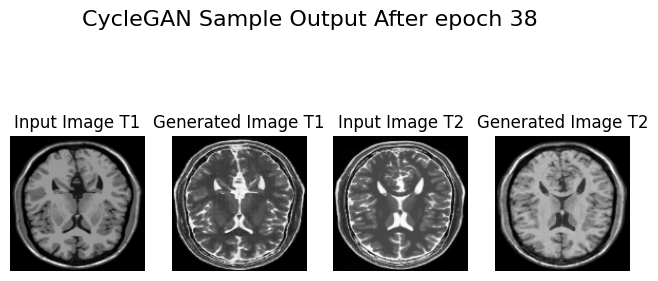

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4734 - F_loss: 4.5938 - D_X_loss: 0.2118 - D_Y_loss: 0.1891 - Total_Generator_Loss: 10.0672
Epoch 39/150
1/1 [==============================] - 0s 23ms/step


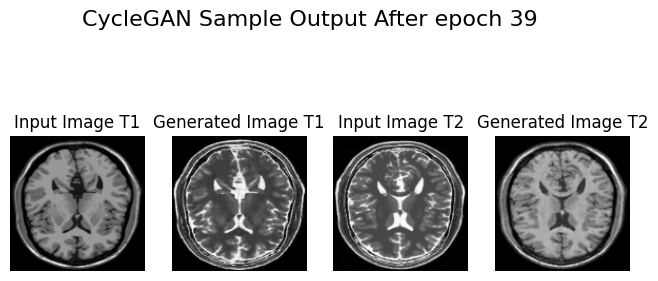

421/421 [==============================] - 65s 154ms/step - G_loss: 5.0725 - F_loss: 4.3697 - D_X_loss: 0.2584 - D_Y_loss: 0.2051 - Total_Generator_Loss: 9.4423
Epoch 40/150
1/1 [==============================] - 0s 22ms/step


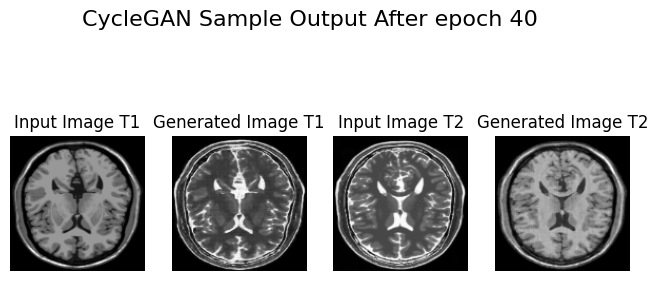

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1574 - F_loss: 4.2062 - D_X_loss: 0.2281 - D_Y_loss: 0.2273 - Total_Generator_Loss: 9.3636
Epoch 41/150
1/1 [==============================] - 0s 22ms/step


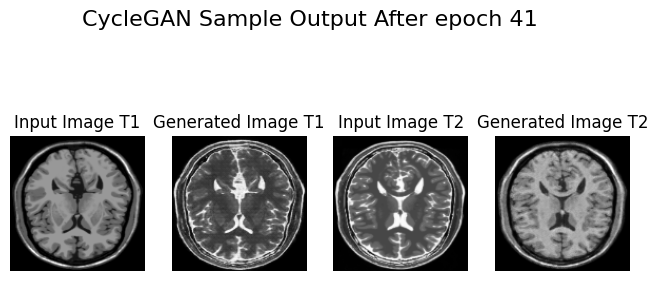

421/421 [==============================] - 65s 154ms/step - G_loss: 5.0798 - F_loss: 4.5073 - D_X_loss: 0.2427 - D_Y_loss: 0.2108 - Total_Generator_Loss: 9.5871
Epoch 42/150
1/1 [==============================] - 0s 21ms/step


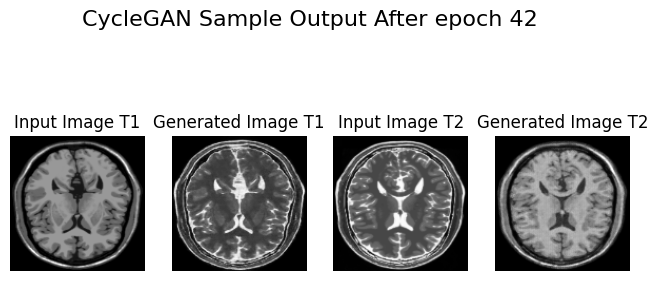

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5434 - F_loss: 4.4615 - D_X_loss: 0.2241 - D_Y_loss: 0.1710 - Total_Generator_Loss: 10.0049
Epoch 43/150
1/1 [==============================] - 0s 20ms/step


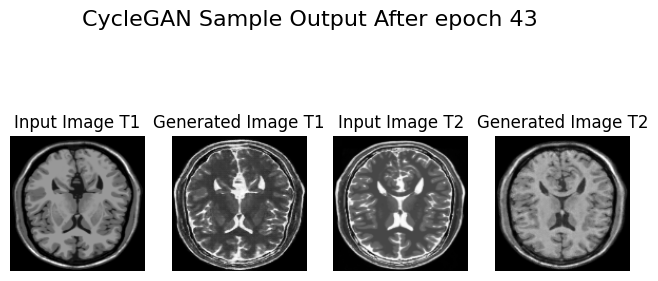

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3070 - F_loss: 4.5537 - D_X_loss: 0.2362 - D_Y_loss: 0.2003 - Total_Generator_Loss: 9.8606
Epoch 44/150
1/1 [==============================] - 0s 21ms/step


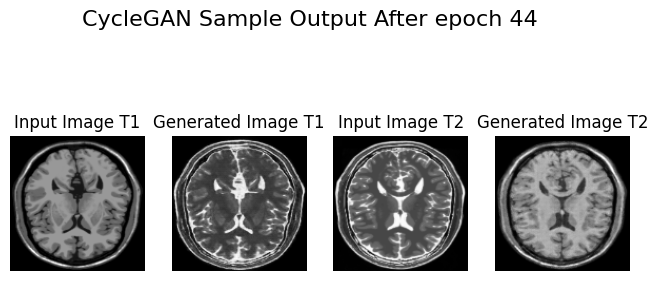

421/421 [==============================] - 65s 154ms/step - G_loss: 5.2290 - F_loss: 4.7048 - D_X_loss: 0.1905 - D_Y_loss: 0.2526 - Total_Generator_Loss: 9.9338
Epoch 45/150
1/1 [==============================] - 0s 21ms/step


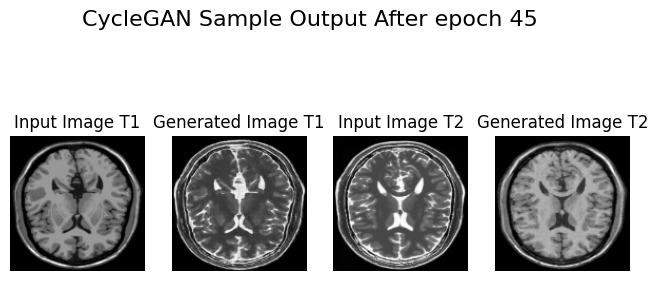

421/421 [==============================] - 66s 156ms/step - G_loss: 5.3142 - F_loss: 4.6682 - D_X_loss: 0.2231 - D_Y_loss: 0.1645 - Total_Generator_Loss: 9.9824
Epoch 46/150
1/1 [==============================] - 0s 21ms/step


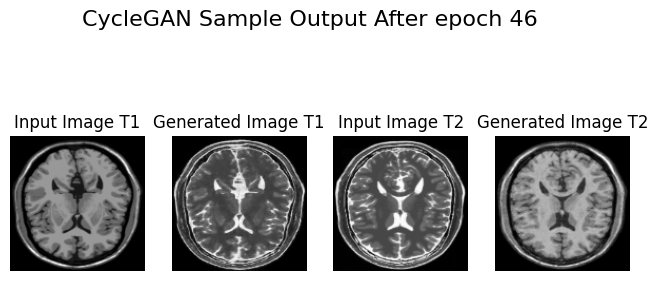

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4647 - F_loss: 4.3741 - D_X_loss: 0.2192 - D_Y_loss: 0.1756 - Total_Generator_Loss: 9.8388
Epoch 47/150
1/1 [==============================] - 0s 22ms/step


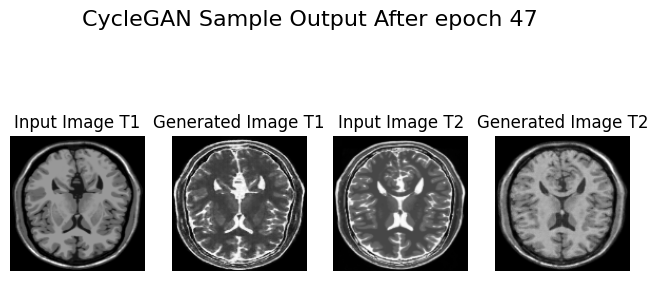

421/421 [==============================] - 65s 154ms/step - G_loss: 5.2363 - F_loss: 4.8261 - D_X_loss: 0.1932 - D_Y_loss: 0.2180 - Total_Generator_Loss: 10.0624
Epoch 48/150
1/1 [==============================] - 0s 24ms/step


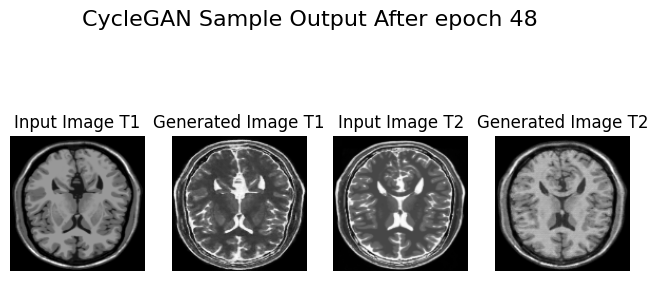

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5544 - F_loss: 4.7320 - D_X_loss: 0.2279 - D_Y_loss: 0.1807 - Total_Generator_Loss: 10.2864
Epoch 49/150
1/1 [==============================] - 0s 20ms/step


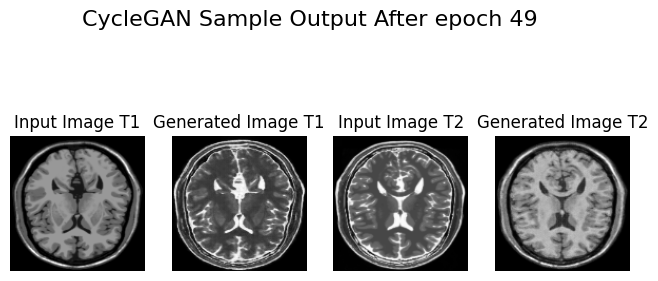

421/421 [==============================] - 65s 153ms/step - G_loss: 5.5145 - F_loss: 4.9167 - D_X_loss: 0.2081 - D_Y_loss: 0.1910 - Total_Generator_Loss: 10.4313
Epoch 50/150
1/1 [==============================] - 0s 21ms/step


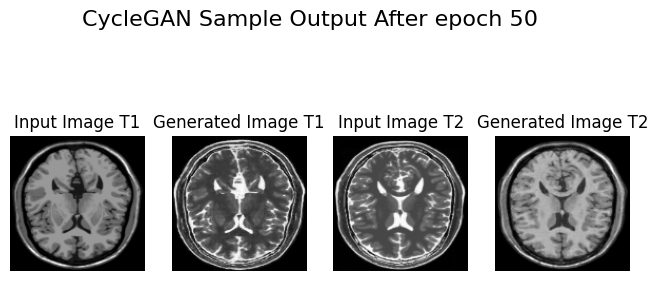

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3772 - F_loss: 4.8378 - D_X_loss: 0.1959 - D_Y_loss: 0.2110 - Total_Generator_Loss: 10.2151
Epoch 51/150
1/1 [==============================] - 0s 21ms/step


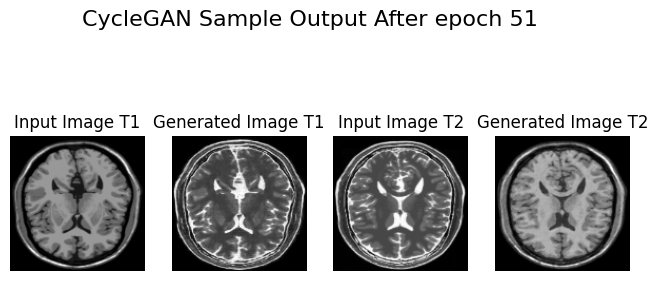

421/421 [==============================] - 65s 153ms/step - G_loss: 5.4218 - F_loss: 4.5882 - D_X_loss: 0.2513 - D_Y_loss: 0.1918 - Total_Generator_Loss: 10.0100
Epoch 52/150
1/1 [==============================] - 0s 20ms/step


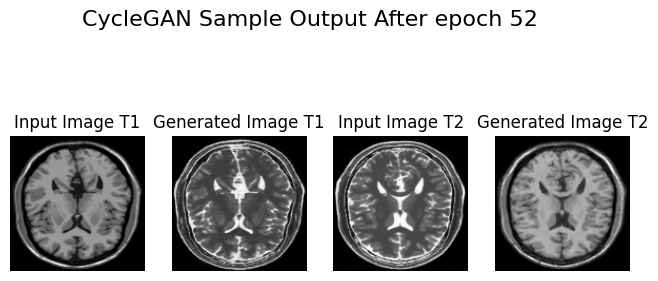

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5033 - F_loss: 4.9896 - D_X_loss: 0.1744 - D_Y_loss: 0.1881 - Total_Generator_Loss: 10.4929
Epoch 53/150
1/1 [==============================] - 0s 20ms/step


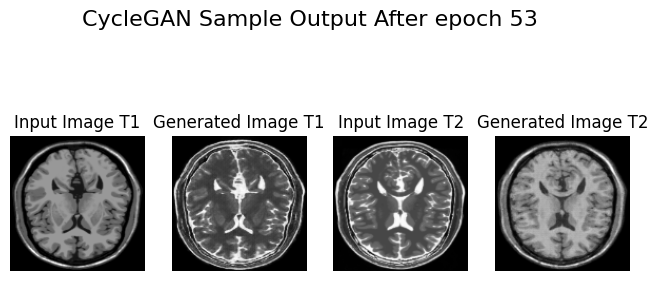

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4766 - F_loss: 4.5418 - D_X_loss: 0.2426 - D_Y_loss: 0.1989 - Total_Generator_Loss: 10.0184
Epoch 54/150
1/1 [==============================] - 0s 26ms/step


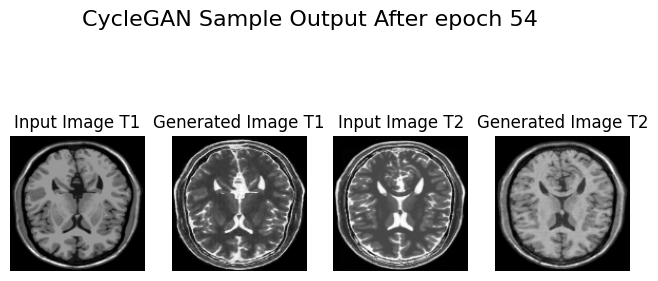

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5180 - F_loss: 4.9037 - D_X_loss: 0.2103 - D_Y_loss: 0.1982 - Total_Generator_Loss: 10.4216
Epoch 55/150
1/1 [==============================] - 0s 21ms/step


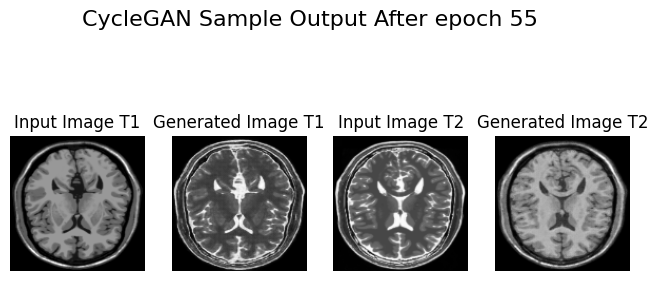

421/421 [==============================] - 65s 154ms/step - G_loss: 5.1484 - F_loss: 4.6418 - D_X_loss: 0.2248 - D_Y_loss: 0.2191 - Total_Generator_Loss: 9.7902
Epoch 56/150
1/1 [==============================] - 0s 20ms/step


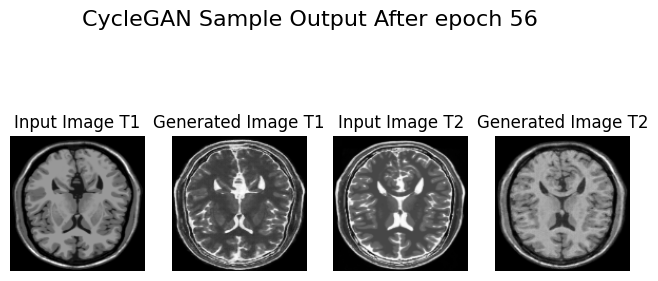

421/421 [==============================] - 65s 154ms/step - G_loss: 5.6228 - F_loss: 4.8782 - D_X_loss: 0.2071 - D_Y_loss: 0.1750 - Total_Generator_Loss: 10.5010
Epoch 57/150
1/1 [==============================] - 0s 20ms/step


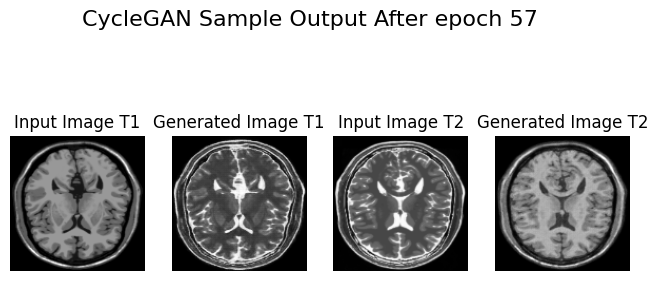

421/421 [==============================] - 65s 154ms/step - G_loss: 5.2871 - F_loss: 5.2247 - D_X_loss: 0.1814 - D_Y_loss: 0.1987 - Total_Generator_Loss: 10.5118
Epoch 58/150
1/1 [==============================] - 0s 21ms/step


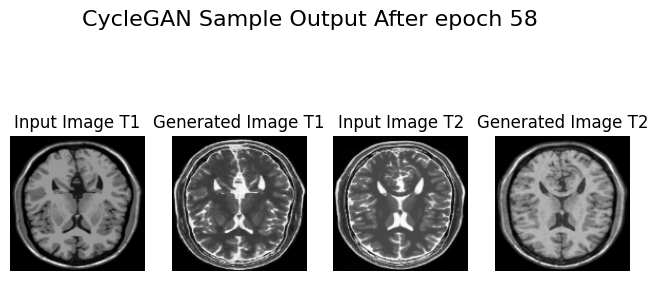

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4895 - F_loss: 4.7281 - D_X_loss: 0.2471 - D_Y_loss: 0.2014 - Total_Generator_Loss: 10.2175
Epoch 59/150
1/1 [==============================] - 0s 23ms/step


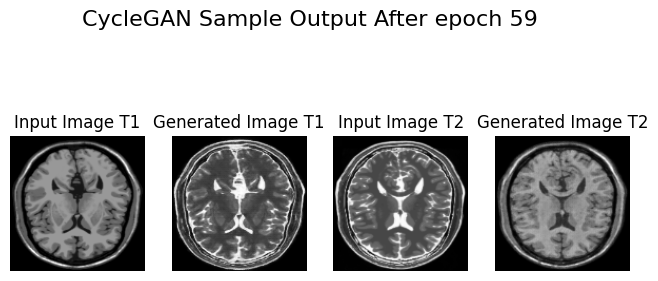

421/421 [==============================] - 65s 154ms/step - G_loss: 5.7140 - F_loss: 4.8150 - D_X_loss: 0.2143 - D_Y_loss: 0.1668 - Total_Generator_Loss: 10.5290
Epoch 60/150
1/1 [==============================] - 0s 22ms/step


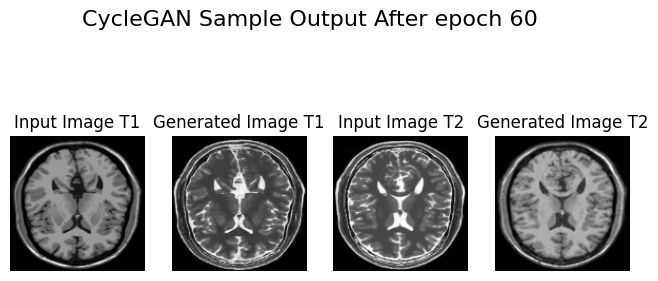

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3884 - F_loss: 4.8081 - D_X_loss: 0.2104 - D_Y_loss: 0.2050 - Total_Generator_Loss: 10.1966
Epoch 61/150
1/1 [==============================] - 0s 22ms/step


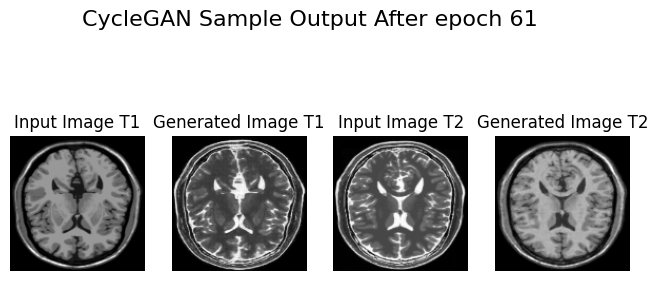

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3056 - F_loss: 4.6120 - D_X_loss: 0.2185 - D_Y_loss: 0.2187 - Total_Generator_Loss: 9.9176
Epoch 62/150
1/1 [==============================] - 0s 23ms/step


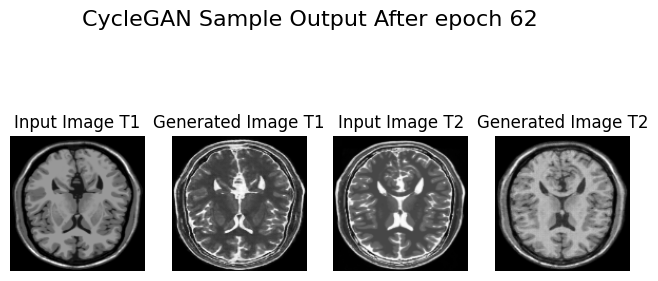

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4007 - F_loss: 4.9537 - D_X_loss: 0.1864 - D_Y_loss: 0.1676 - Total_Generator_Loss: 10.3544
Epoch 63/150
1/1 [==============================] - 0s 22ms/step


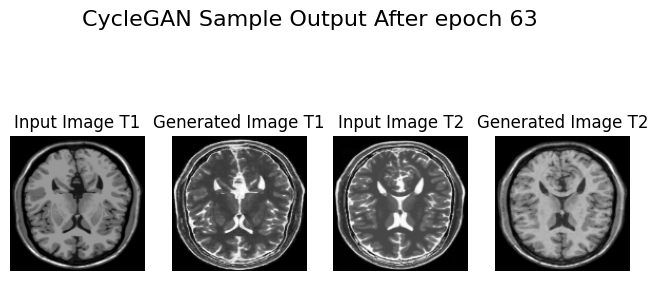

421/421 [==============================] - 65s 154ms/step - G_loss: 5.7040 - F_loss: 4.9222 - D_X_loss: 0.2273 - D_Y_loss: 0.1562 - Total_Generator_Loss: 10.6261
Epoch 64/150
1/1 [==============================] - 0s 23ms/step


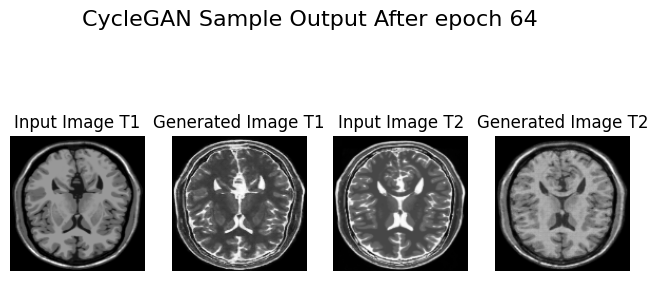

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5963 - F_loss: 4.8828 - D_X_loss: 0.1922 - D_Y_loss: 0.1759 - Total_Generator_Loss: 10.4792
Epoch 65/150
1/1 [==============================] - 0s 21ms/step


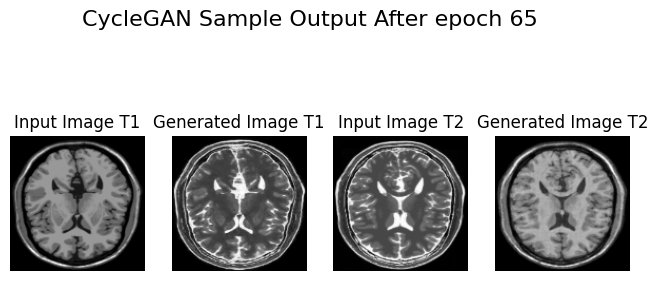

421/421 [==============================] - 65s 154ms/step - G_loss: 5.8021 - F_loss: 4.8065 - D_X_loss: 0.2139 - D_Y_loss: 0.1872 - Total_Generator_Loss: 10.6086
Epoch 66/150
1/1 [==============================] - 0s 22ms/step


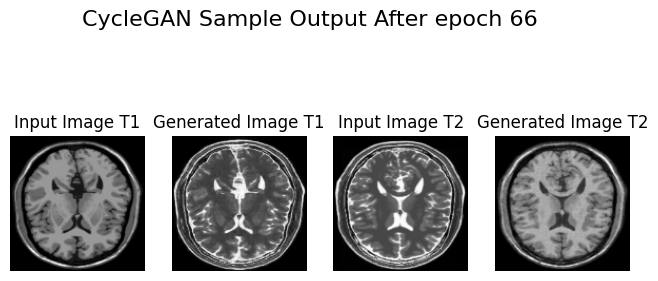

421/421 [==============================] - 65s 154ms/step - G_loss: 4.9582 - F_loss: 5.0393 - D_X_loss: 0.1984 - D_Y_loss: 0.2304 - Total_Generator_Loss: 9.9975
Epoch 67/150
1/1 [==============================] - 0s 22ms/step


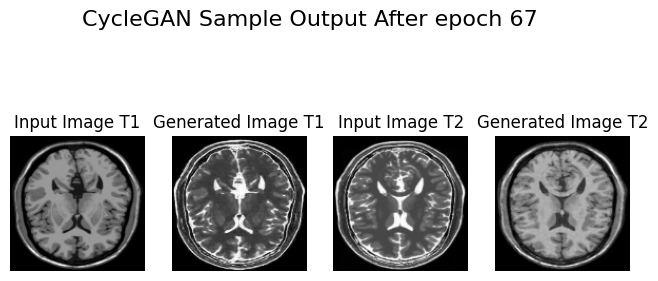

421/421 [==============================] - 65s 155ms/step - G_loss: 5.2748 - F_loss: 4.5300 - D_X_loss: 0.2528 - D_Y_loss: 0.1987 - Total_Generator_Loss: 9.8048
Epoch 68/150
1/1 [==============================] - 0s 22ms/step


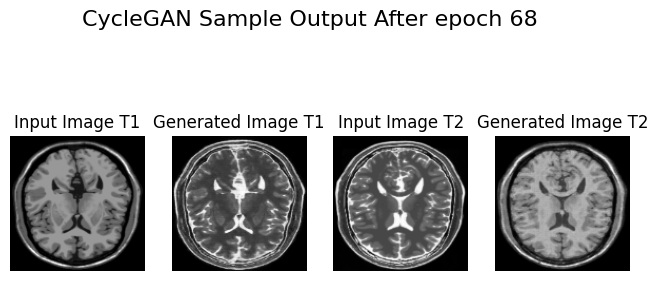

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3853 - F_loss: 4.9528 - D_X_loss: 0.1809 - D_Y_loss: 0.2014 - Total_Generator_Loss: 10.3380
Epoch 69/150
1/1 [==============================] - 0s 26ms/step


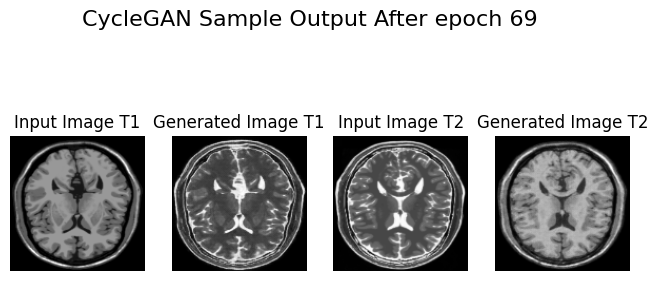

421/421 [==============================] - 66s 156ms/step - G_loss: 5.2177 - F_loss: 5.0323 - D_X_loss: 0.2143 - D_Y_loss: 0.1974 - Total_Generator_Loss: 10.2499
Epoch 70/150
1/1 [==============================] - 0s 28ms/step


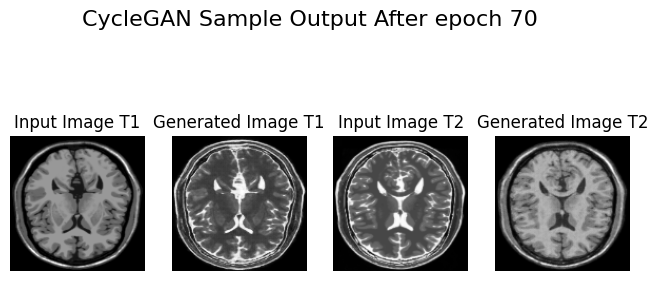

421/421 [==============================] - 65s 155ms/step - G_loss: 5.5772 - F_loss: 5.1567 - D_X_loss: 0.1614 - D_Y_loss: 0.1785 - Total_Generator_Loss: 10.7339
Epoch 71/150
1/1 [==============================] - 0s 24ms/step


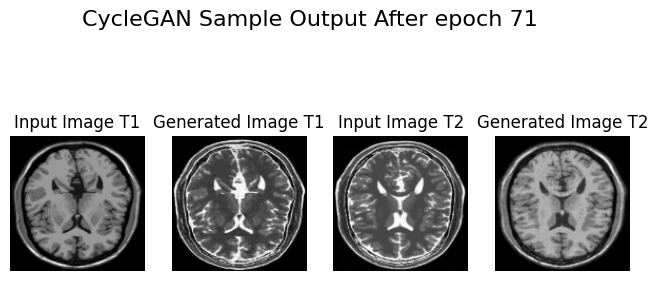

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4861 - F_loss: 4.9243 - D_X_loss: 0.2305 - D_Y_loss: 0.2031 - Total_Generator_Loss: 10.4104
Epoch 72/150
1/1 [==============================] - 0s 22ms/step


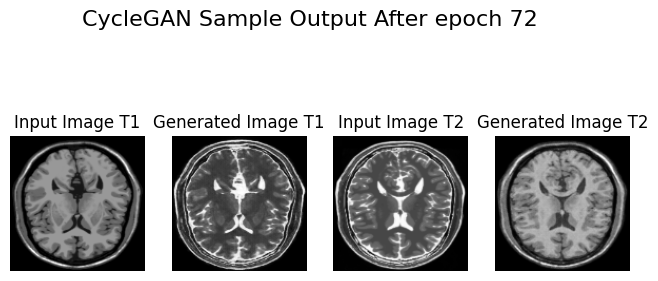

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5973 - F_loss: 5.2346 - D_X_loss: 0.1804 - D_Y_loss: 0.1651 - Total_Generator_Loss: 10.8319
Epoch 73/150
1/1 [==============================] - 0s 24ms/step


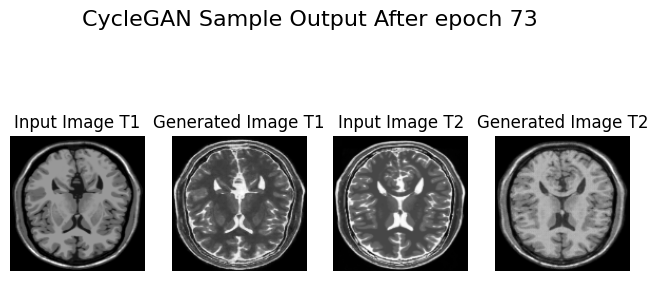

421/421 [==============================] - 65s 155ms/step - G_loss: 5.5502 - F_loss: 4.7871 - D_X_loss: 0.2329 - D_Y_loss: 0.1754 - Total_Generator_Loss: 10.3372
Epoch 74/150
1/1 [==============================] - 0s 22ms/step


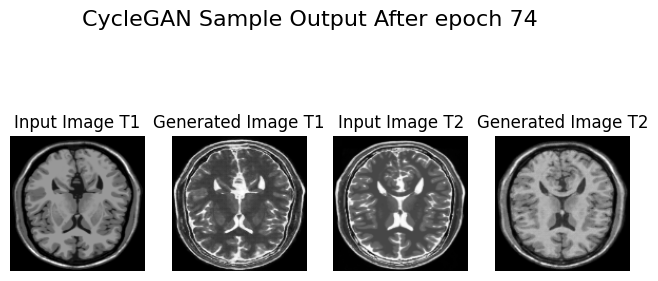

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4775 - F_loss: 4.9028 - D_X_loss: 0.2013 - D_Y_loss: 0.2045 - Total_Generator_Loss: 10.3803
Epoch 75/150
1/1 [==============================] - 0s 22ms/step


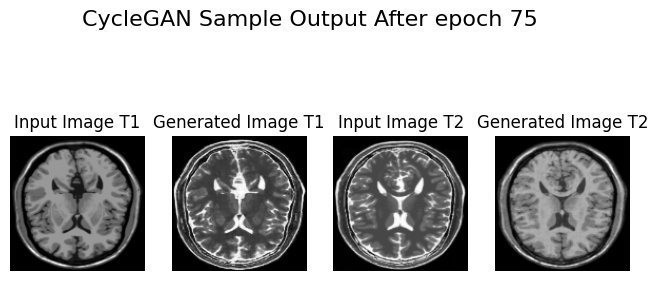

421/421 [==============================] - 65s 154ms/step - G_loss: 4.9299 - F_loss: 5.1040 - D_X_loss: 0.1928 - D_Y_loss: 0.2425 - Total_Generator_Loss: 10.0340
Epoch 76/150
1/1 [==============================] - 0s 22ms/step


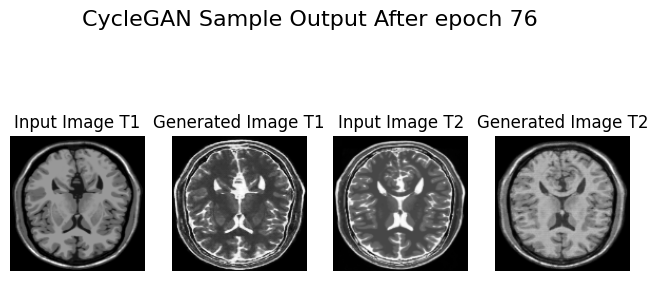

421/421 [==============================] - 65s 154ms/step - G_loss: 5.6554 - F_loss: 5.0602 - D_X_loss: 0.2075 - D_Y_loss: 0.1523 - Total_Generator_Loss: 10.7155
Epoch 77/150
1/1 [==============================] - 0s 23ms/step


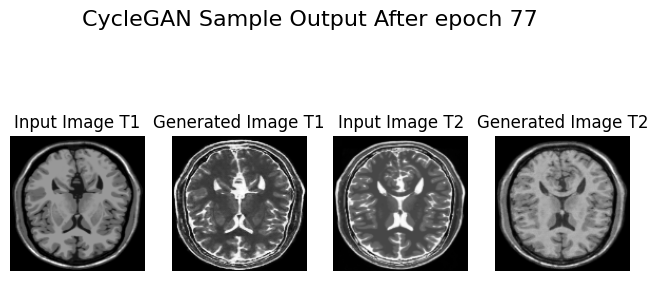

421/421 [==============================] - 65s 154ms/step - G_loss: 5.8679 - F_loss: 4.5690 - D_X_loss: 0.2451 - D_Y_loss: 0.1692 - Total_Generator_Loss: 10.4369
Epoch 78/150
1/1 [==============================] - 0s 22ms/step


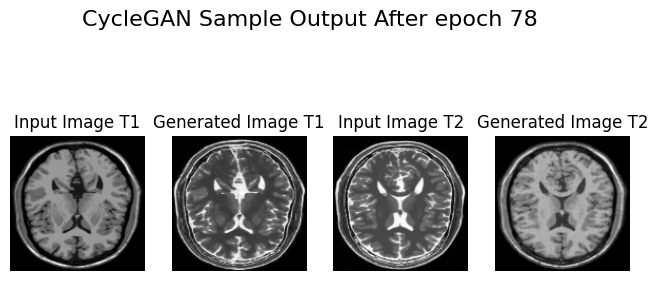

421/421 [==============================] - 65s 154ms/step - G_loss: 5.6552 - F_loss: 5.4389 - D_X_loss: 0.1609 - D_Y_loss: 0.1800 - Total_Generator_Loss: 11.0941
Epoch 79/150
1/1 [==============================] - 0s 22ms/step


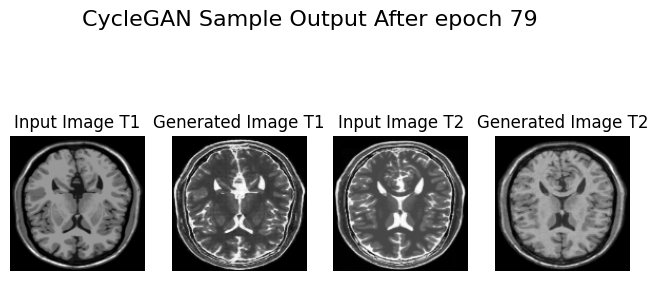

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5727 - F_loss: 4.8340 - D_X_loss: 0.2059 - D_Y_loss: 0.1902 - Total_Generator_Loss: 10.4068
Epoch 80/150
1/1 [==============================] - 0s 21ms/step


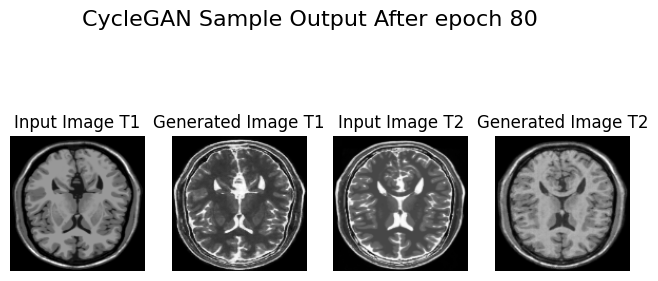

421/421 [==============================] - 65s 154ms/step - G_loss: 5.2658 - F_loss: 5.3789 - D_X_loss: 0.1772 - D_Y_loss: 0.2164 - Total_Generator_Loss: 10.6447
Epoch 81/150
1/1 [==============================] - 0s 21ms/step


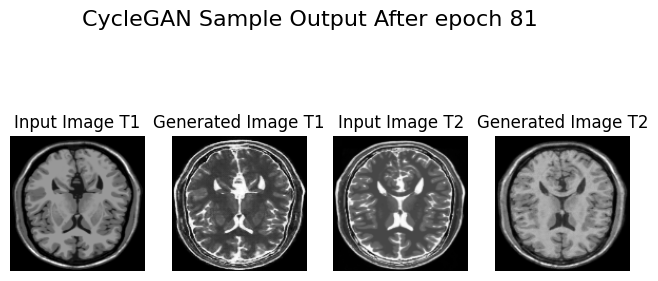

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5599 - F_loss: 5.0217 - D_X_loss: 0.2183 - D_Y_loss: 0.1816 - Total_Generator_Loss: 10.5816
Epoch 82/150
1/1 [==============================] - 0s 21ms/step


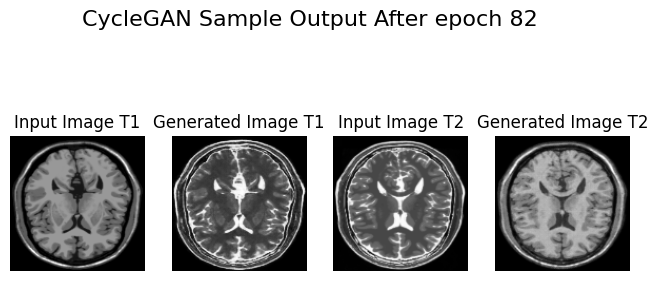

421/421 [==============================] - 65s 154ms/step - G_loss: 5.0417 - F_loss: 5.0158 - D_X_loss: 0.1903 - D_Y_loss: 0.2533 - Total_Generator_Loss: 10.0576
Epoch 83/150
1/1 [==============================] - 0s 20ms/step


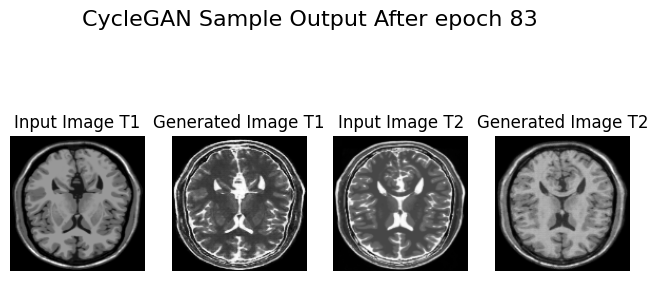

421/421 [==============================] - 65s 154ms/step - G_loss: 5.8484 - F_loss: 5.0886 - D_X_loss: 0.1893 - D_Y_loss: 0.1235 - Total_Generator_Loss: 10.9370
Epoch 84/150
1/1 [==============================] - 0s 20ms/step


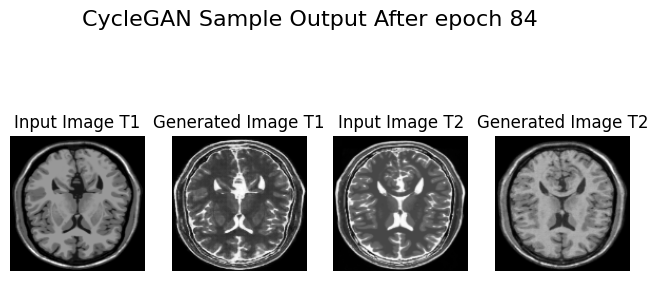

421/421 [==============================] - 65s 154ms/step - G_loss: 5.7882 - F_loss: 5.0481 - D_X_loss: 0.2176 - D_Y_loss: 0.1964 - Total_Generator_Loss: 10.8363
Epoch 85/150
1/1 [==============================] - 0s 22ms/step


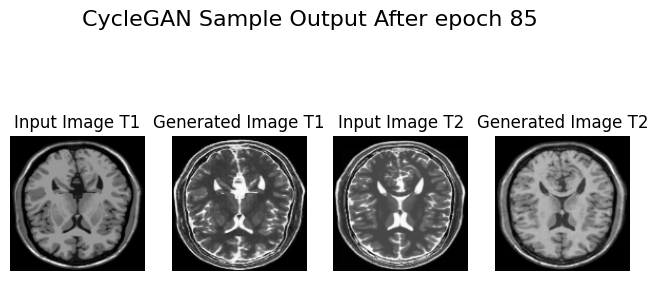

421/421 [==============================] - 65s 154ms/step - G_loss: 5.7512 - F_loss: 5.3266 - D_X_loss: 0.1655 - D_Y_loss: 0.1724 - Total_Generator_Loss: 11.0777
Epoch 86/150
1/1 [==============================] - 0s 20ms/step


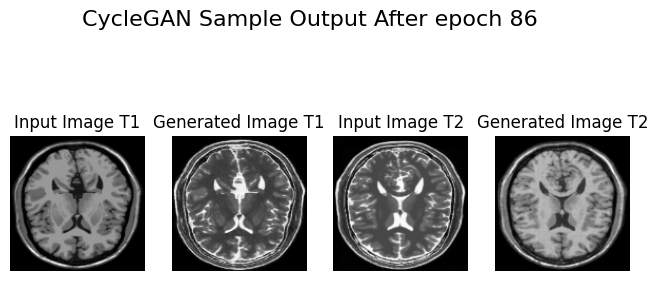

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5063 - F_loss: 4.5669 - D_X_loss: 0.2762 - D_Y_loss: 0.2020 - Total_Generator_Loss: 10.0732
Epoch 87/150
1/1 [==============================] - 0s 22ms/step


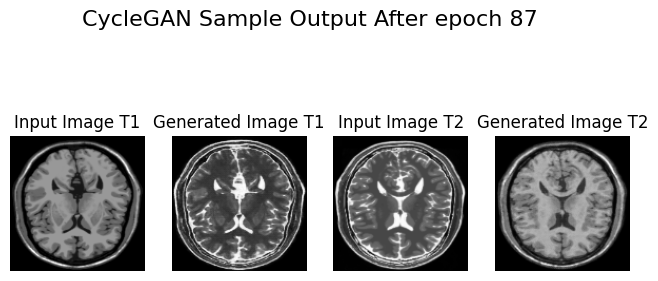

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3634 - F_loss: 5.2236 - D_X_loss: 0.1271 - D_Y_loss: 0.1978 - Total_Generator_Loss: 10.5870
Epoch 88/150
1/1 [==============================] - 0s 21ms/step


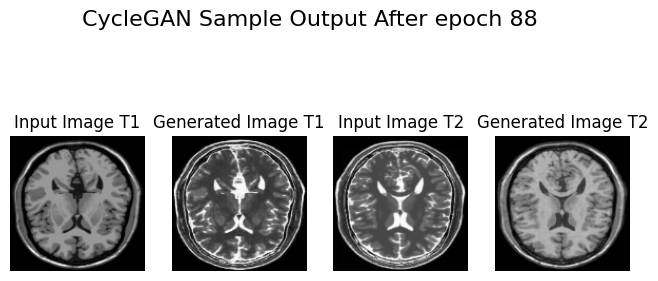

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5757 - F_loss: 5.1619 - D_X_loss: 0.1983 - D_Y_loss: 0.1805 - Total_Generator_Loss: 10.7377
Epoch 89/150
1/1 [==============================] - 0s 22ms/step


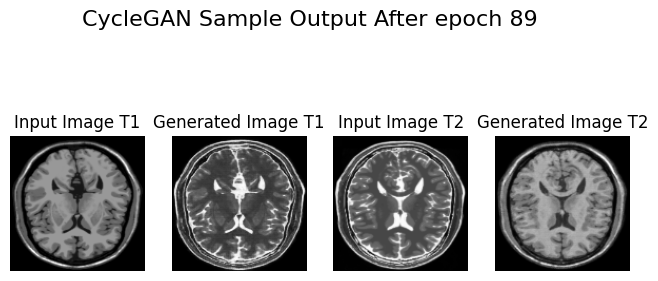

421/421 [==============================] - 65s 154ms/step - G_loss: 5.7103 - F_loss: 5.1645 - D_X_loss: 0.2203 - D_Y_loss: 0.1650 - Total_Generator_Loss: 10.8748
Epoch 90/150
1/1 [==============================] - 0s 27ms/step


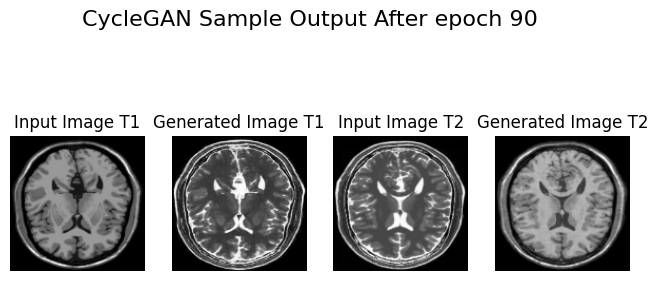

421/421 [==============================] - 65s 154ms/step - G_loss: 5.0516 - F_loss: 4.9534 - D_X_loss: 0.2107 - D_Y_loss: 0.2336 - Total_Generator_Loss: 10.0050
Epoch 91/150
1/1 [==============================] - 0s 22ms/step


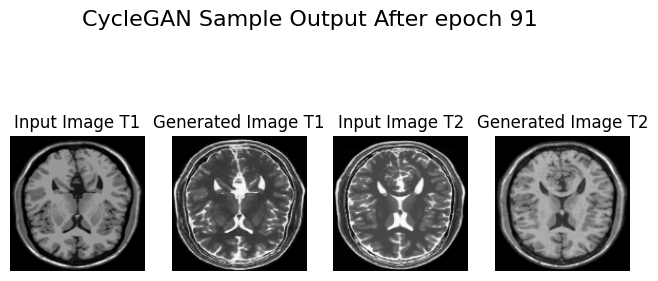

421/421 [==============================] - 65s 154ms/step - G_loss: 5.4474 - F_loss: 5.4129 - D_X_loss: 0.1672 - D_Y_loss: 0.1680 - Total_Generator_Loss: 10.8603
Epoch 92/150
1/1 [==============================] - 0s 24ms/step


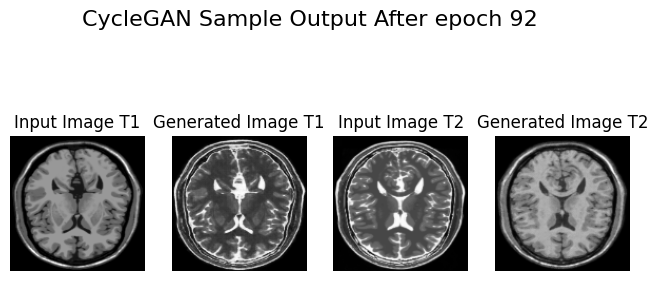

421/421 [==============================] - 66s 156ms/step - G_loss: 5.8273 - F_loss: 5.0328 - D_X_loss: 0.2112 - D_Y_loss: 0.1648 - Total_Generator_Loss: 10.8602
Epoch 93/150
1/1 [==============================] - 0s 28ms/step


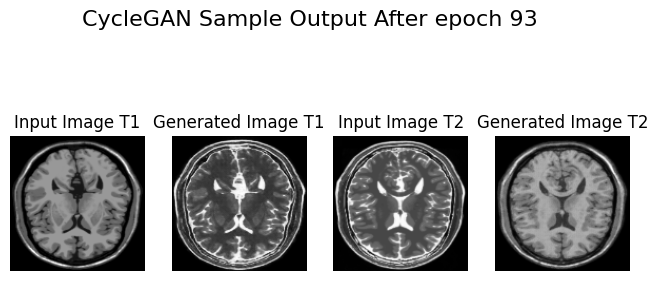

421/421 [==============================] - 65s 155ms/step - G_loss: 5.4597 - F_loss: 4.9854 - D_X_loss: 0.2164 - D_Y_loss: 0.2011 - Total_Generator_Loss: 10.4451
Epoch 94/150
1/1 [==============================] - 0s 24ms/step


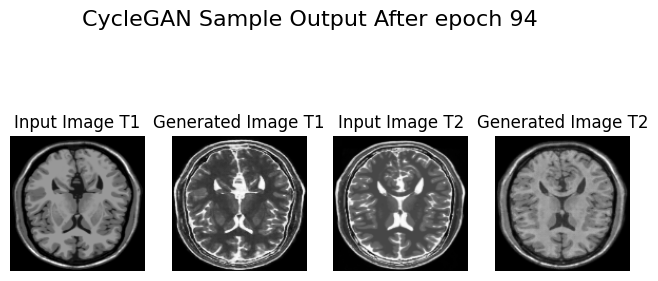

421/421 [==============================] - 65s 154ms/step - G_loss: 5.5278 - F_loss: 5.0854 - D_X_loss: 0.1970 - D_Y_loss: 0.1850 - Total_Generator_Loss: 10.6132
Epoch 95/150
1/1 [==============================] - 0s 21ms/step


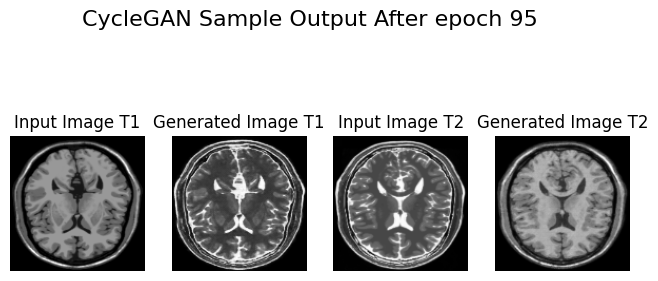

421/421 [==============================] - 65s 154ms/step - G_loss: 6.1816 - F_loss: 5.3321 - D_X_loss: 0.1683 - D_Y_loss: 0.1130 - Total_Generator_Loss: 11.5136
Epoch 96/150
1/1 [==============================] - 0s 23ms/step


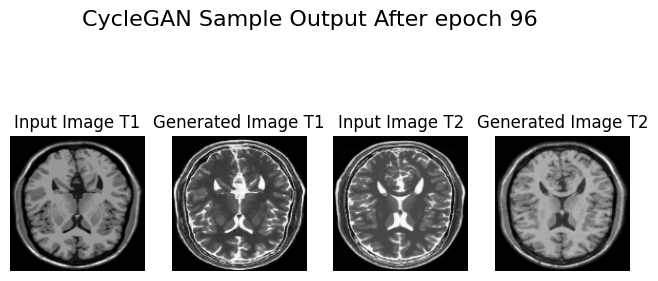

421/421 [==============================] - 65s 154ms/step - G_loss: 5.8575 - F_loss: 4.8923 - D_X_loss: 0.2215 - D_Y_loss: 0.1956 - Total_Generator_Loss: 10.7498
Epoch 97/150
1/1 [==============================] - 0s 21ms/step


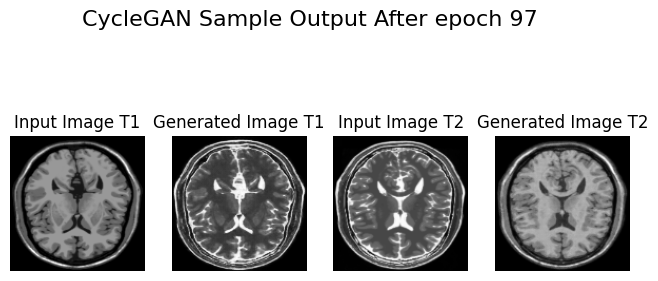

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3751 - F_loss: 4.8910 - D_X_loss: 0.2226 - D_Y_loss: 0.2332 - Total_Generator_Loss: 10.2661
Epoch 98/150
1/1 [==============================] - 0s 22ms/step


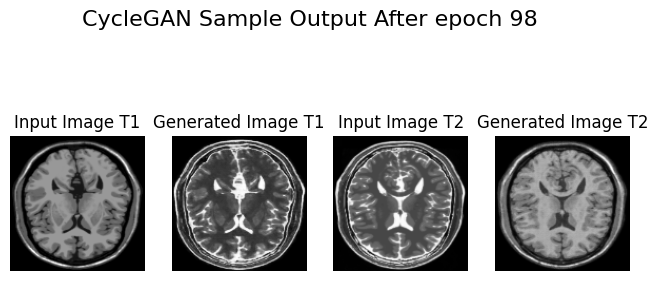

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3644 - F_loss: 4.9180 - D_X_loss: 0.2108 - D_Y_loss: 0.1744 - Total_Generator_Loss: 10.2824
Epoch 99/150
1/1 [==============================] - 0s 21ms/step


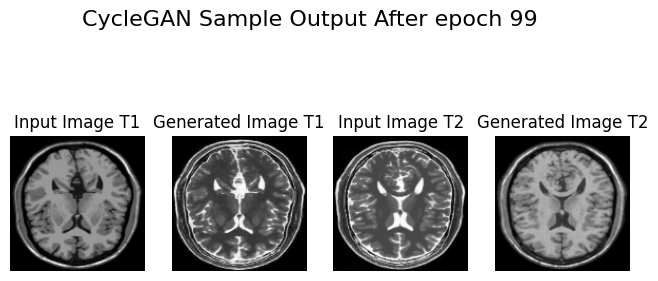

421/421 [==============================] - 65s 154ms/step - G_loss: 5.6409 - F_loss: 5.5492 - D_X_loss: 0.1680 - D_Y_loss: 0.1896 - Total_Generator_Loss: 11.1900
Epoch 100/150
1/1 [==============================] - 0s 20ms/step


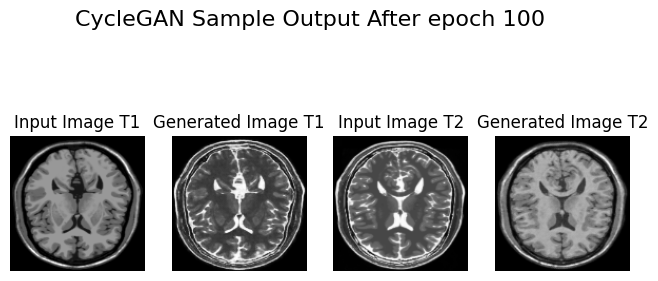

421/421 [==============================] - 65s 154ms/step - G_loss: 5.3403 - F_loss: 4.9343 - D_X_loss: 0.2174 - D_Y_loss: 0.1918 - Total_Generator_Loss: 10.2746
Epoch 101/150
1/1 [==============================] - 0s 22ms/step


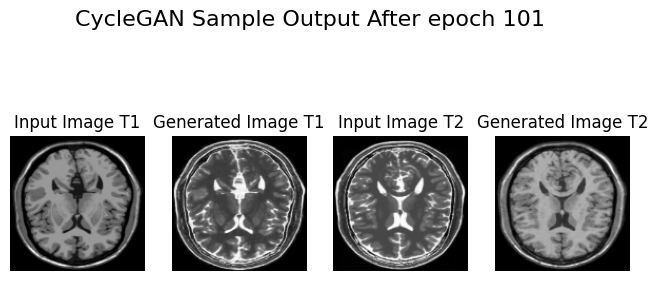

421/421 [==============================] - 64s 153ms/step - G_loss: 5.4632 - F_loss: 5.3628 - D_X_loss: 0.1732 - D_Y_loss: 0.1884 - Total_Generator_Loss: 10.8260
Epoch 102/150
1/1 [==============================] - 0s 21ms/step


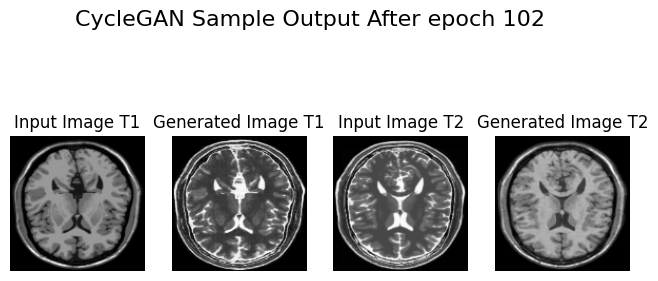

421/421 [==============================] - 64s 153ms/step - G_loss: 5.6456 - F_loss: 4.9377 - D_X_loss: 0.2086 - D_Y_loss: 0.1613 - Total_Generator_Loss: 10.5832
Epoch 103/150
1/1 [==============================] - 0s 20ms/step


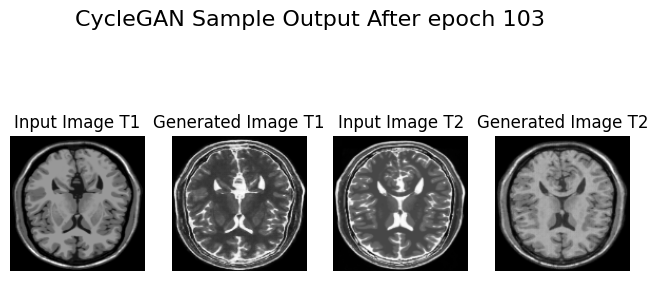

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5841 - F_loss: 5.2195 - D_X_loss: 0.2252 - D_Y_loss: 0.1896 - Total_Generator_Loss: 10.8035
Epoch 104/150
1/1 [==============================] - 0s 22ms/step


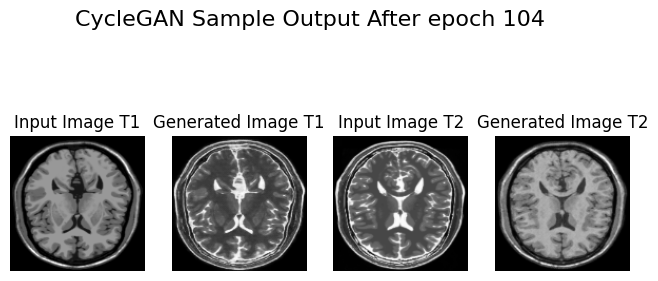

421/421 [==============================] - 64s 153ms/step - G_loss: 5.7649 - F_loss: 5.0631 - D_X_loss: 0.1928 - D_Y_loss: 0.1900 - Total_Generator_Loss: 10.8280
Epoch 105/150
1/1 [==============================] - 0s 22ms/step


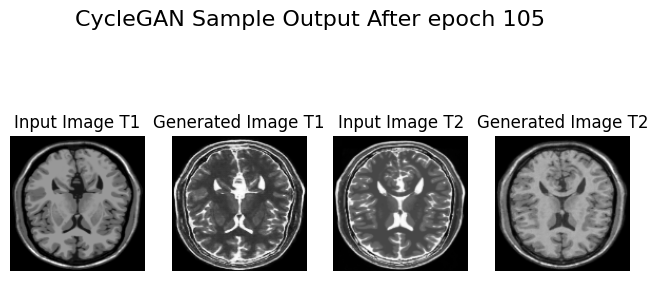

421/421 [==============================] - 64s 153ms/step - G_loss: 5.7787 - F_loss: 4.8523 - D_X_loss: 0.2364 - D_Y_loss: 0.1487 - Total_Generator_Loss: 10.6310
Epoch 106/150
1/1 [==============================] - 0s 19ms/step


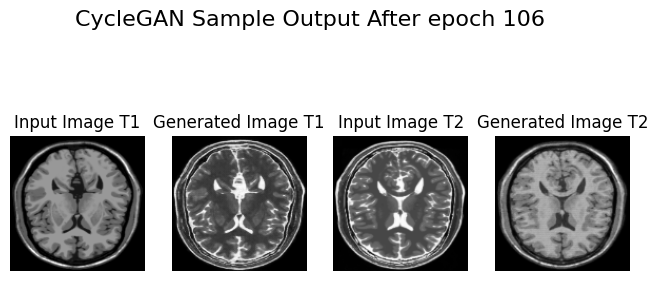

421/421 [==============================] - 64s 153ms/step - G_loss: 5.1439 - F_loss: 4.9841 - D_X_loss: 0.1995 - D_Y_loss: 0.2381 - Total_Generator_Loss: 10.1281
Epoch 107/150
1/1 [==============================] - 0s 23ms/step


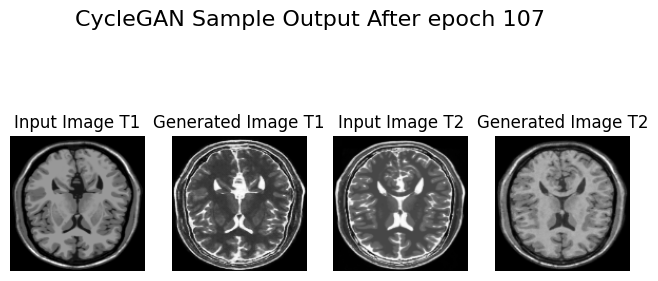

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5961 - F_loss: 5.2544 - D_X_loss: 0.1857 - D_Y_loss: 0.1688 - Total_Generator_Loss: 10.8505
Epoch 108/150
1/1 [==============================] - 0s 21ms/step


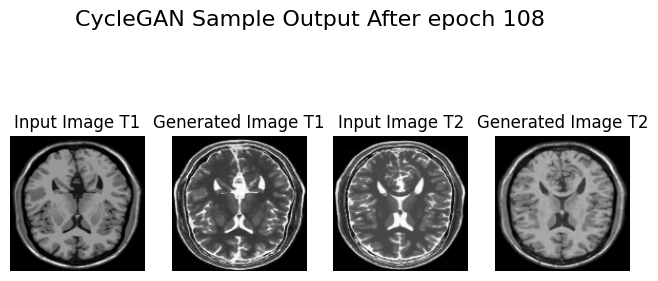

421/421 [==============================] - 64s 153ms/step - G_loss: 5.3717 - F_loss: 4.9434 - D_X_loss: 0.1922 - D_Y_loss: 0.2051 - Total_Generator_Loss: 10.3151
Epoch 109/150
1/1 [==============================] - 0s 20ms/step


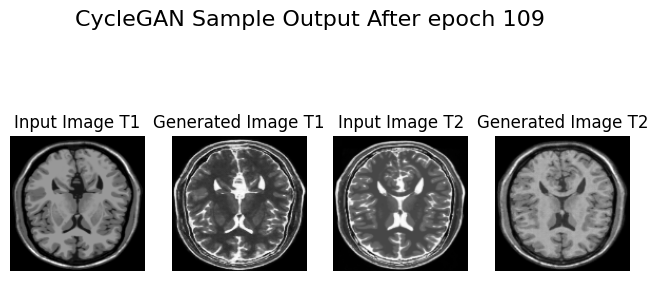

421/421 [==============================] - 64s 153ms/step - G_loss: 5.2235 - F_loss: 5.1077 - D_X_loss: 0.1893 - D_Y_loss: 0.2006 - Total_Generator_Loss: 10.3312
Epoch 110/150
1/1 [==============================] - 0s 20ms/step


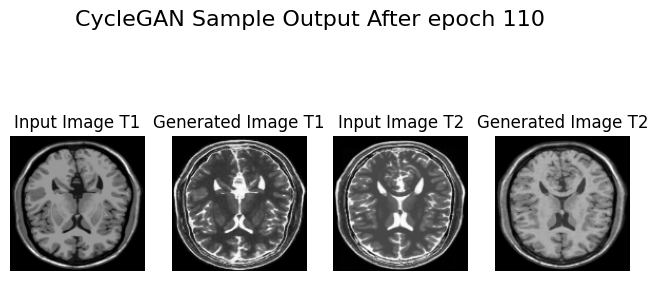

421/421 [==============================] - 64s 153ms/step - G_loss: 5.9523 - F_loss: 5.1506 - D_X_loss: 0.2085 - D_Y_loss: 0.1500 - Total_Generator_Loss: 11.1029
Epoch 111/150
1/1 [==============================] - 0s 21ms/step


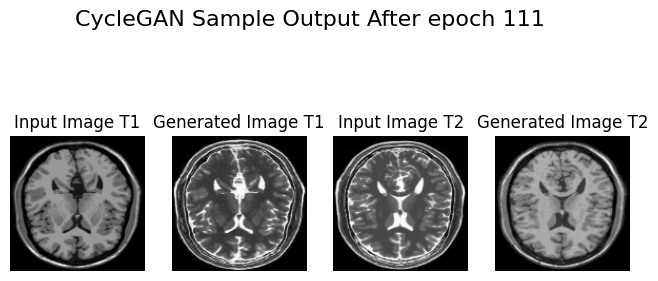

421/421 [==============================] - 64s 153ms/step - G_loss: 5.8099 - F_loss: 5.0997 - D_X_loss: 0.1893 - D_Y_loss: 0.1638 - Total_Generator_Loss: 10.9096
Epoch 112/150
1/1 [==============================] - 0s 22ms/step


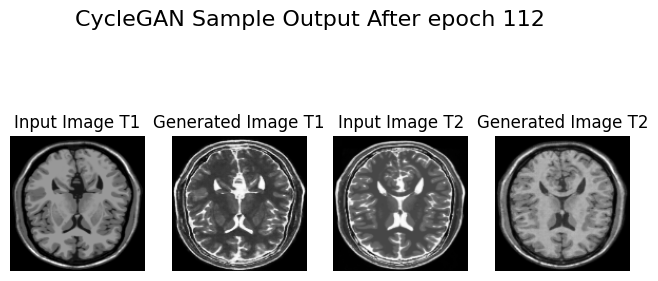

421/421 [==============================] - 64s 153ms/step - G_loss: 5.4887 - F_loss: 5.4804 - D_X_loss: 0.1610 - D_Y_loss: 0.1787 - Total_Generator_Loss: 10.9691
Epoch 113/150
1/1 [==============================] - 0s 22ms/step


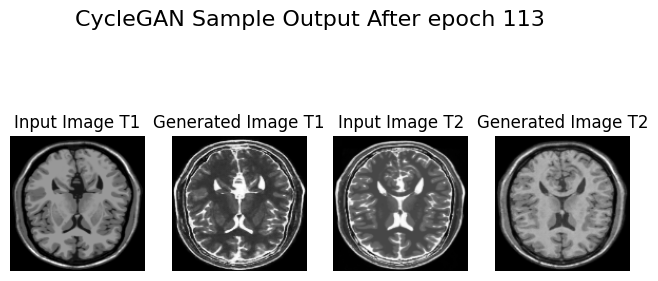

421/421 [==============================] - 64s 153ms/step - G_loss: 5.3247 - F_loss: 5.4390 - D_X_loss: 0.1734 - D_Y_loss: 0.2103 - Total_Generator_Loss: 10.7637
Epoch 114/150
1/1 [==============================] - 0s 21ms/step


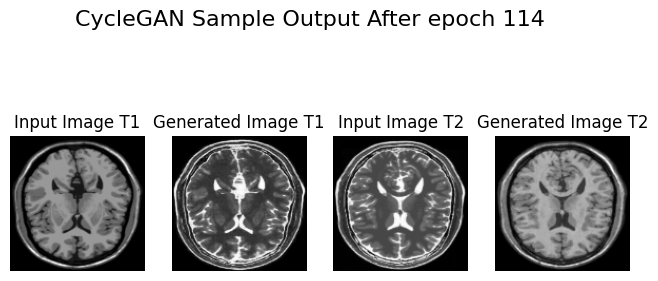

421/421 [==============================] - 64s 153ms/step - G_loss: 5.3357 - F_loss: 5.0444 - D_X_loss: 0.2094 - D_Y_loss: 0.1748 - Total_Generator_Loss: 10.3801
Epoch 115/150
1/1 [==============================] - 0s 23ms/step


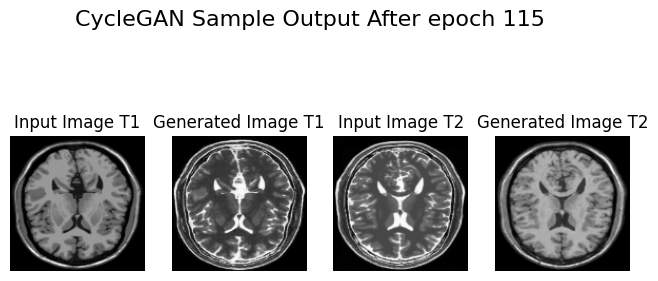

421/421 [==============================] - 65s 155ms/step - G_loss: 5.8591 - F_loss: 5.2919 - D_X_loss: 0.1735 - D_Y_loss: 0.1747 - Total_Generator_Loss: 11.1510
Epoch 116/150
1/1 [==============================] - 0s 23ms/step


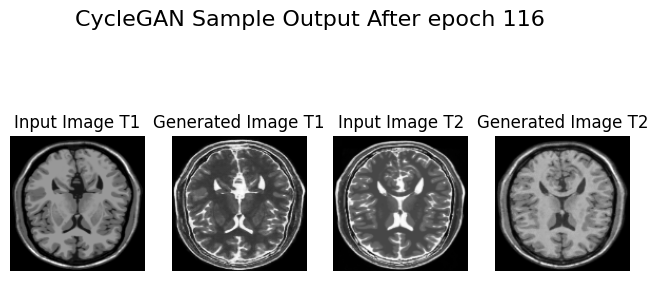

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5569 - F_loss: 5.0289 - D_X_loss: 0.2259 - D_Y_loss: 0.1879 - Total_Generator_Loss: 10.5858
Epoch 117/150
1/1 [==============================] - 0s 22ms/step


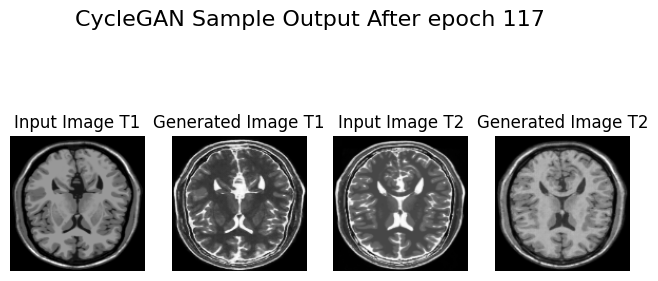

421/421 [==============================] - 64s 153ms/step - G_loss: 5.0641 - F_loss: 4.8454 - D_X_loss: 0.2259 - D_Y_loss: 0.2291 - Total_Generator_Loss: 9.9096
Epoch 118/150
1/1 [==============================] - 0s 21ms/step


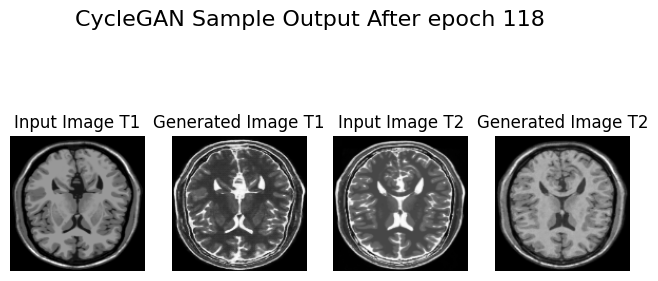

421/421 [==============================] - 64s 153ms/step - G_loss: 5.2838 - F_loss: 5.0721 - D_X_loss: 0.2058 - D_Y_loss: 0.1916 - Total_Generator_Loss: 10.3559
Epoch 119/150
1/1 [==============================] - 0s 23ms/step


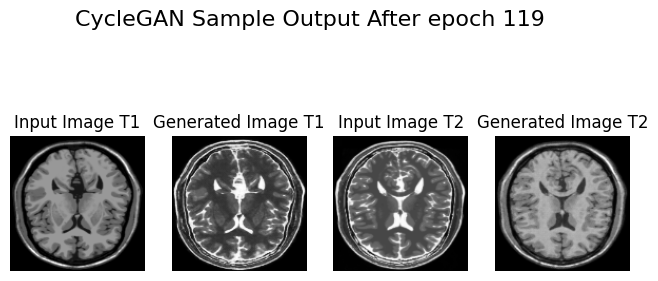

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5975 - F_loss: 5.1221 - D_X_loss: 0.1729 - D_Y_loss: 0.1641 - Total_Generator_Loss: 10.7196
Epoch 120/150
1/1 [==============================] - 0s 23ms/step


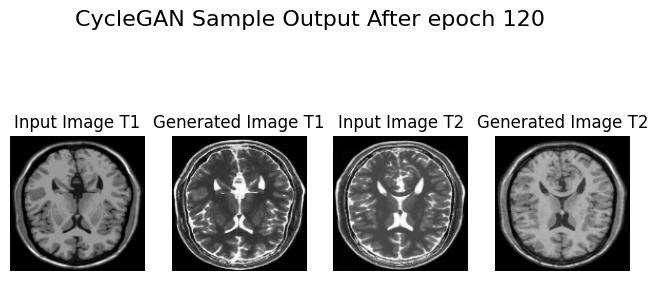

421/421 [==============================] - 64s 153ms/step - G_loss: 5.6348 - F_loss: 5.0351 - D_X_loss: 0.2126 - D_Y_loss: 0.1727 - Total_Generator_Loss: 10.6700
Epoch 121/150
1/1 [==============================] - 0s 23ms/step


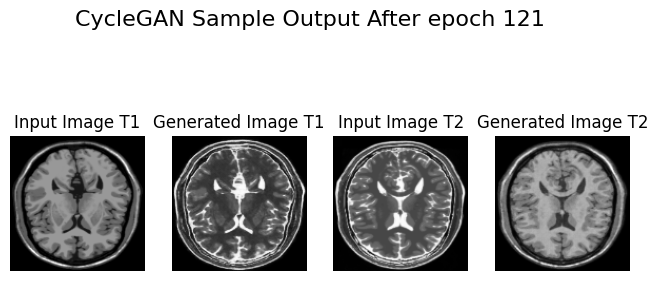

421/421 [==============================] - 64s 153ms/step - G_loss: 6.0180 - F_loss: 4.9576 - D_X_loss: 0.2081 - D_Y_loss: 0.1424 - Total_Generator_Loss: 10.9756
Epoch 122/150
1/1 [==============================] - 0s 24ms/step


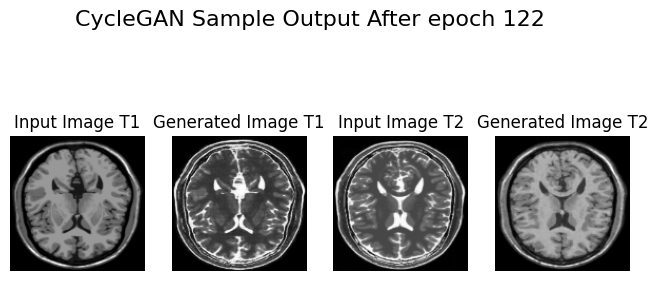

421/421 [==============================] - 64s 153ms/step - G_loss: 5.4463 - F_loss: 5.2141 - D_X_loss: 0.1908 - D_Y_loss: 0.2276 - Total_Generator_Loss: 10.6605
Epoch 123/150
1/1 [==============================] - 0s 23ms/step


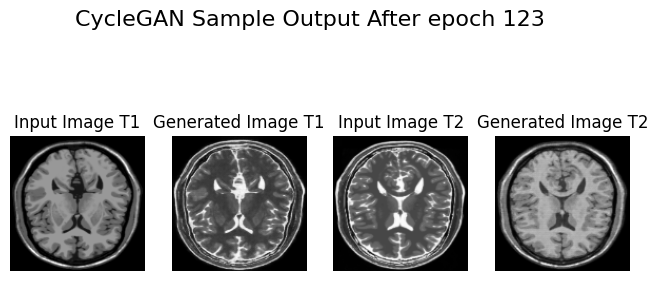

421/421 [==============================] - 64s 153ms/step - G_loss: 5.4783 - F_loss: 4.8973 - D_X_loss: 0.2181 - D_Y_loss: 0.1874 - Total_Generator_Loss: 10.3756
Epoch 124/150
1/1 [==============================] - 0s 24ms/step


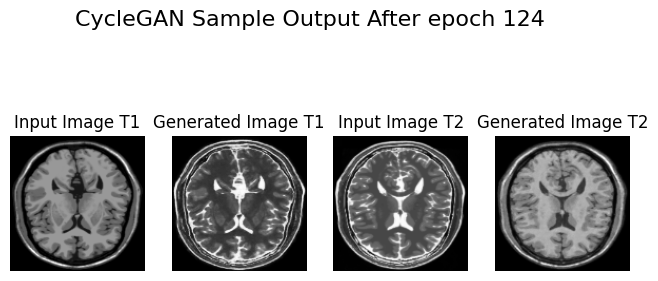

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5140 - F_loss: 5.5816 - D_X_loss: 0.1589 - D_Y_loss: 0.2076 - Total_Generator_Loss: 11.0956
Epoch 125/150
1/1 [==============================] - 0s 21ms/step


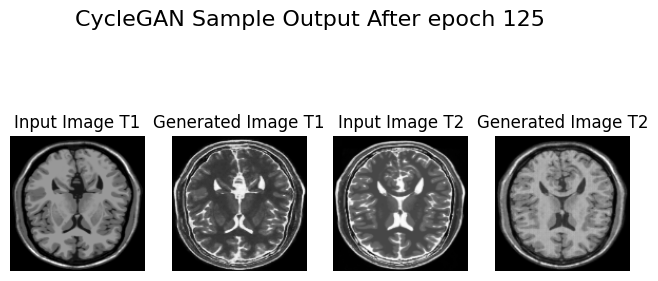

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5364 - F_loss: 5.2686 - D_X_loss: 0.1811 - D_Y_loss: 0.1680 - Total_Generator_Loss: 10.8050
Epoch 126/150
1/1 [==============================] - 0s 22ms/step


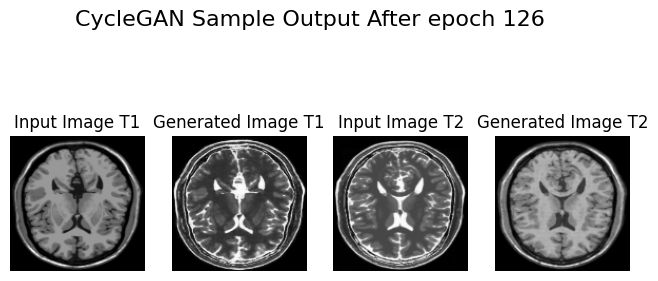

421/421 [==============================] - 64s 153ms/step - G_loss: 5.7834 - F_loss: 4.8955 - D_X_loss: 0.2174 - D_Y_loss: 0.1515 - Total_Generator_Loss: 10.6789
Epoch 127/150
1/1 [==============================] - 0s 23ms/step


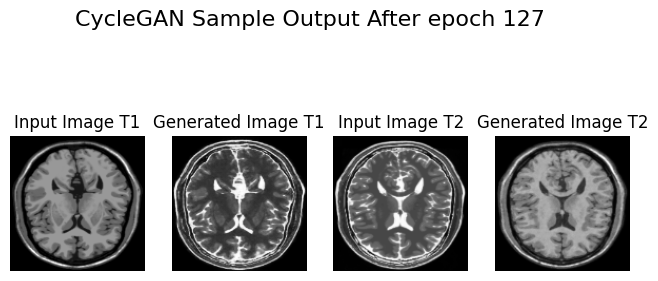

421/421 [==============================] - 64s 153ms/step - G_loss: 5.4092 - F_loss: 4.9827 - D_X_loss: 0.2088 - D_Y_loss: 0.2192 - Total_Generator_Loss: 10.3919
Epoch 128/150
1/1 [==============================] - 0s 23ms/step


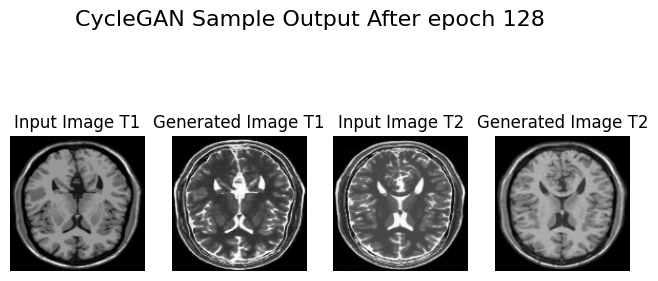

421/421 [==============================] - 64s 153ms/step - G_loss: 5.6379 - F_loss: 5.0755 - D_X_loss: 0.2082 - D_Y_loss: 0.1595 - Total_Generator_Loss: 10.7135
Epoch 129/150
1/1 [==============================] - 0s 22ms/step


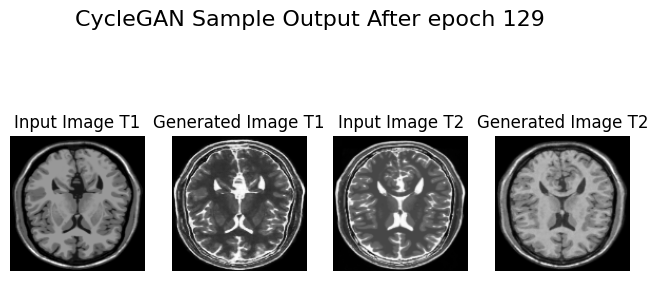

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5131 - F_loss: 5.1557 - D_X_loss: 0.1858 - D_Y_loss: 0.1948 - Total_Generator_Loss: 10.6688
Epoch 130/150
1/1 [==============================] - 0s 22ms/step


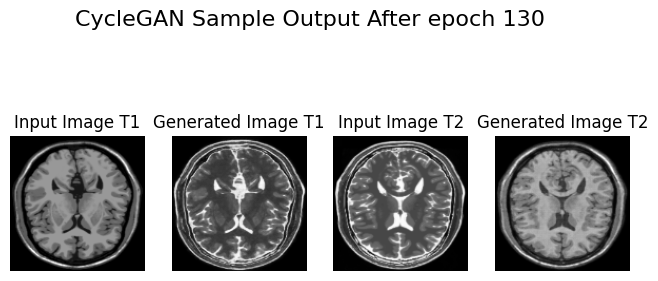

421/421 [==============================] - 64s 153ms/step - G_loss: 5.3882 - F_loss: 4.9225 - D_X_loss: 0.2219 - D_Y_loss: 0.1969 - Total_Generator_Loss: 10.3107
Epoch 131/150
1/1 [==============================] - 0s 22ms/step


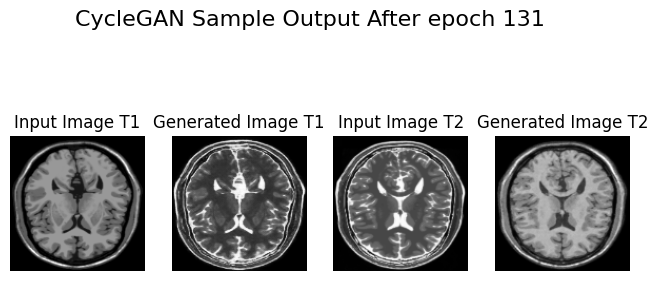

421/421 [==============================] - 64s 153ms/step - G_loss: 5.3625 - F_loss: 5.4958 - D_X_loss: 0.1600 - D_Y_loss: 0.1933 - Total_Generator_Loss: 10.8583
Epoch 132/150
1/1 [==============================] - 0s 22ms/step


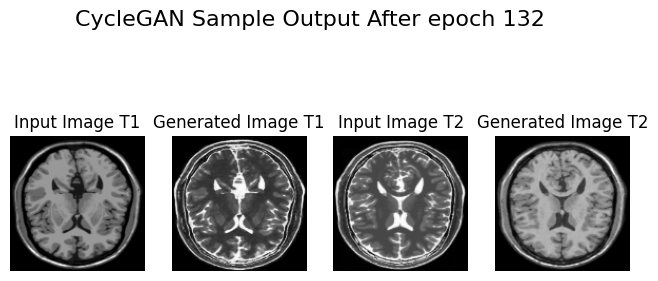

421/421 [==============================] - 64s 153ms/step - G_loss: 5.3952 - F_loss: 5.3528 - D_X_loss: 0.1737 - D_Y_loss: 0.1819 - Total_Generator_Loss: 10.7480
Epoch 133/150
1/1 [==============================] - 0s 21ms/step


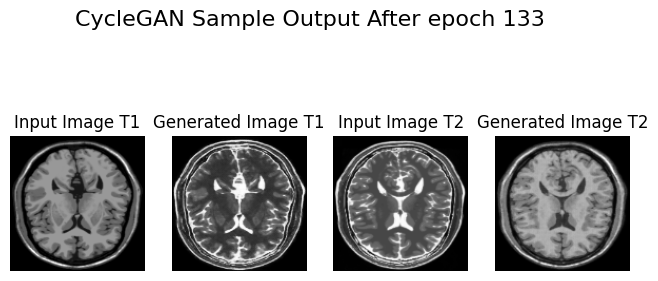

421/421 [==============================] - 64s 153ms/step - G_loss: 5.7932 - F_loss: 4.9429 - D_X_loss: 0.2236 - D_Y_loss: 0.1556 - Total_Generator_Loss: 10.7361
Epoch 134/150
1/1 [==============================] - 0s 21ms/step


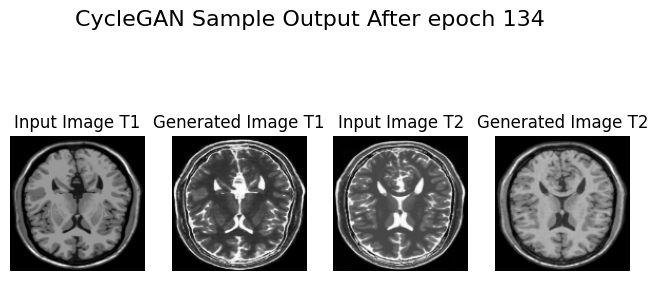

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5875 - F_loss: 4.9291 - D_X_loss: 0.1949 - D_Y_loss: 0.1781 - Total_Generator_Loss: 10.5166
Epoch 135/150
1/1 [==============================] - 0s 21ms/step


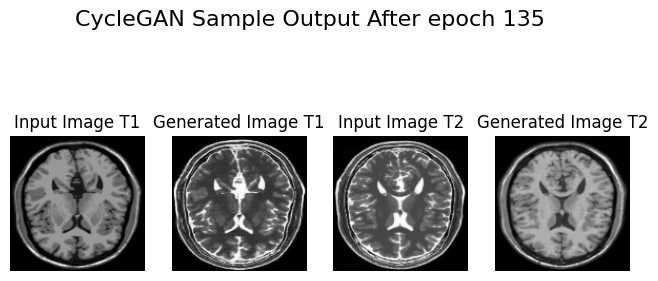

421/421 [==============================] - 64s 153ms/step - G_loss: 5.6527 - F_loss: 5.5036 - D_X_loss: 0.1584 - D_Y_loss: 0.1913 - Total_Generator_Loss: 11.1562
Epoch 136/150
1/1 [==============================] - 0s 26ms/step


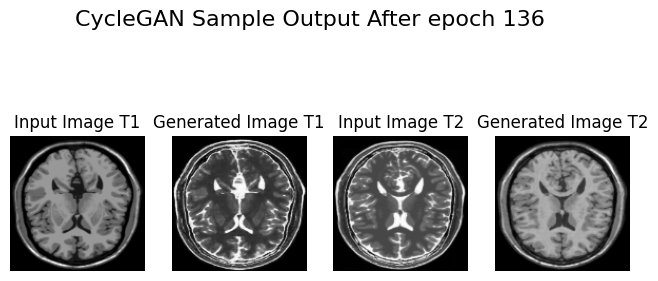

421/421 [==============================] - 64s 153ms/step - G_loss: 5.4121 - F_loss: 4.9273 - D_X_loss: 0.2146 - D_Y_loss: 0.1917 - Total_Generator_Loss: 10.3394
Epoch 137/150
1/1 [==============================] - 0s 21ms/step


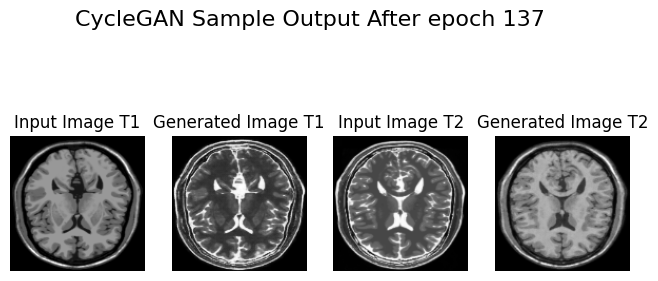

421/421 [==============================] - 64s 153ms/step - G_loss: 5.6211 - F_loss: 4.9407 - D_X_loss: 0.2058 - D_Y_loss: 0.1856 - Total_Generator_Loss: 10.5618
Epoch 138/150
1/1 [==============================] - 0s 22ms/step


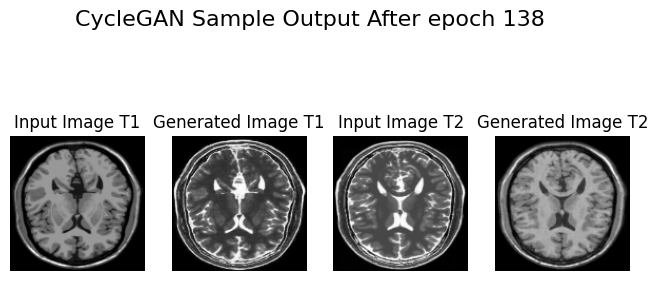

421/421 [==============================] - 64s 153ms/step - G_loss: 5.9229 - F_loss: 5.5462 - D_X_loss: 0.1422 - D_Y_loss: 0.1466 - Total_Generator_Loss: 11.4690
Epoch 139/150
1/1 [==============================] - 0s 21ms/step


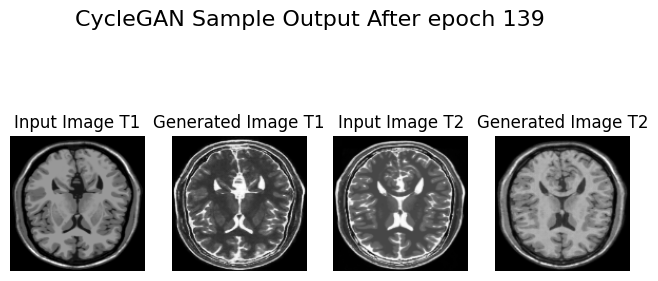

421/421 [==============================] - 65s 155ms/step - G_loss: 5.2605 - F_loss: 5.4393 - D_X_loss: 0.1933 - D_Y_loss: 0.2341 - Total_Generator_Loss: 10.6998
Epoch 140/150
1/1 [==============================] - 0s 25ms/step


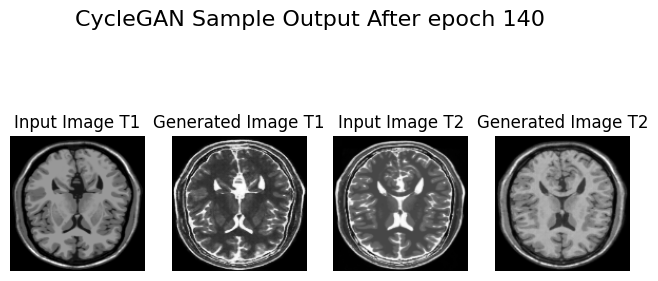

421/421 [==============================] - 64s 153ms/step - G_loss: 5.5681 - F_loss: 5.5485 - D_X_loss: 0.1813 - D_Y_loss: 0.1554 - Total_Generator_Loss: 11.1166
Epoch 141/150
1/1 [==============================] - 0s 24ms/step


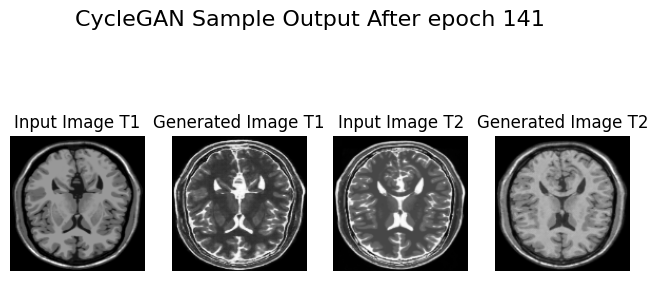

421/421 [==============================] - 64s 153ms/step - G_loss: 5.8811 - F_loss: 5.1326 - D_X_loss: 0.1829 - D_Y_loss: 0.1450 - Total_Generator_Loss: 11.0137
Epoch 142/150
1/1 [==============================] - 0s 23ms/step


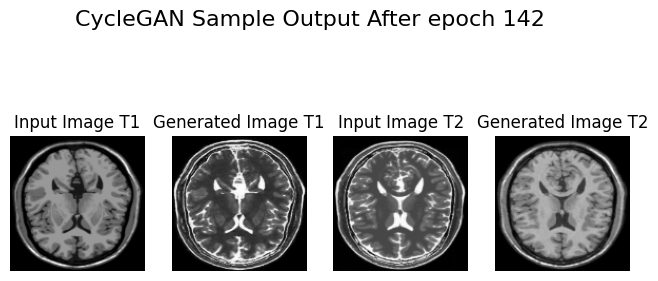

421/421 [==============================] - 64s 153ms/step - G_loss: 5.4909 - F_loss: 5.4144 - D_X_loss: 0.1857 - D_Y_loss: 0.2099 - Total_Generator_Loss: 10.9052
Epoch 143/150
1/1 [==============================] - 0s 24ms/step


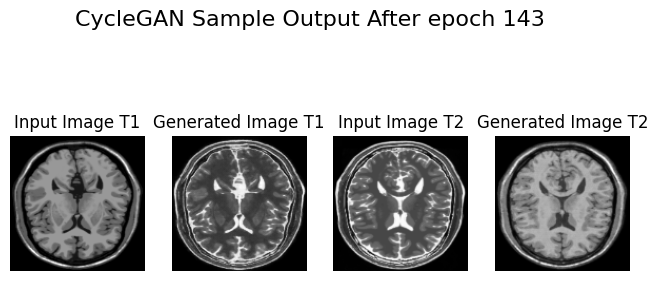

421/421 [==============================] - 64s 153ms/step - G_loss: 5.8508 - F_loss: 4.9403 - D_X_loss: 0.2223 - D_Y_loss: 0.1298 - Total_Generator_Loss: 10.7911
Epoch 144/150
1/1 [==============================] - 0s 23ms/step


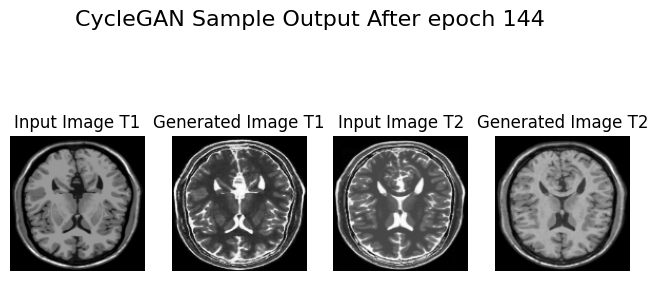

421/421 [==============================] - 64s 153ms/step - G_loss: 5.8569 - F_loss: 4.8410 - D_X_loss: 0.2202 - D_Y_loss: 0.1995 - Total_Generator_Loss: 10.6978
Epoch 145/150
1/1 [==============================] - 0s 22ms/step


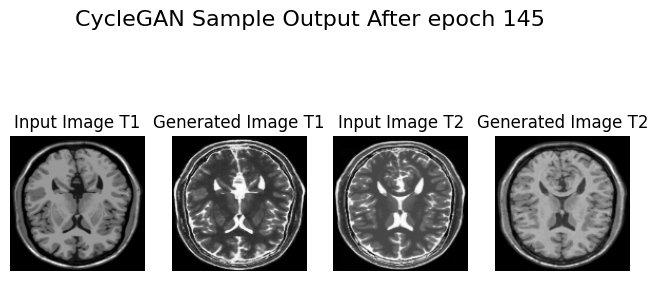

421/421 [==============================] - 64s 153ms/step - G_loss: 5.1642 - F_loss: 5.1992 - D_X_loss: 0.1811 - D_Y_loss: 0.2015 - Total_Generator_Loss: 10.3633
Epoch 146/150
1/1 [==============================] - 0s 23ms/step


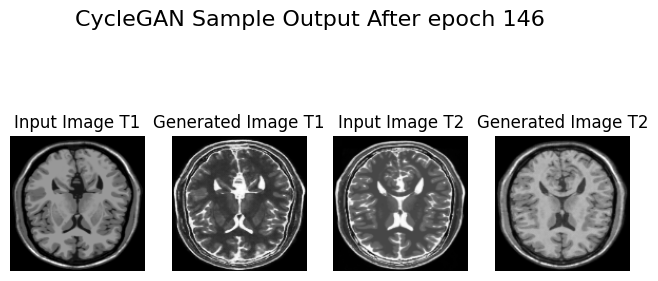

421/421 [==============================] - 64s 153ms/step - G_loss: 5.8165 - F_loss: 5.3673 - D_X_loss: 0.1706 - D_Y_loss: 0.1262 - Total_Generator_Loss: 11.1838
Epoch 147/150
1/1 [==============================] - 0s 22ms/step


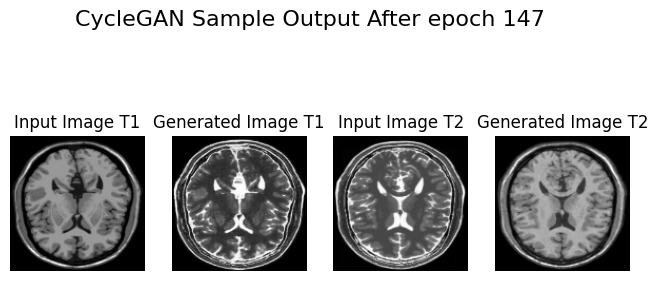

421/421 [==============================] - 64s 153ms/step - G_loss: 5.6435 - F_loss: 5.4876 - D_X_loss: 0.1787 - D_Y_loss: 0.2002 - Total_Generator_Loss: 11.1311
Epoch 148/150
1/1 [==============================] - 0s 23ms/step


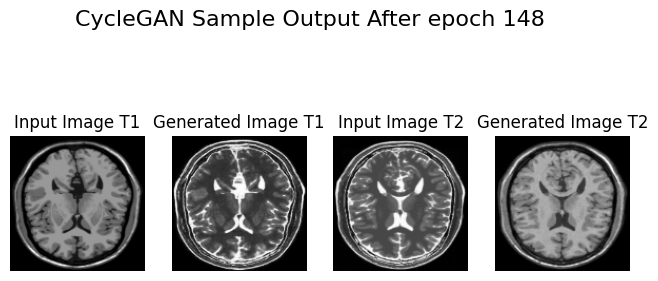

421/421 [==============================] - 64s 153ms/step - G_loss: 5.2436 - F_loss: 5.0742 - D_X_loss: 0.1977 - D_Y_loss: 0.2250 - Total_Generator_Loss: 10.3178
Epoch 149/150
1/1 [==============================] - 0s 23ms/step


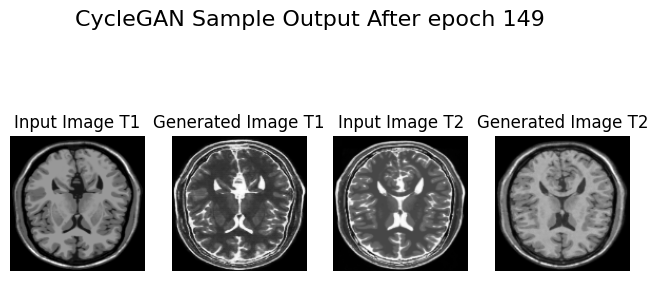

421/421 [==============================] - 64s 153ms/step - G_loss: 5.6649 - F_loss: 4.9924 - D_X_loss: 0.2014 - D_Y_loss: 0.1681 - Total_Generator_Loss: 10.6573
Epoch 150/150
1/1 [==============================] - 0s 23ms/step


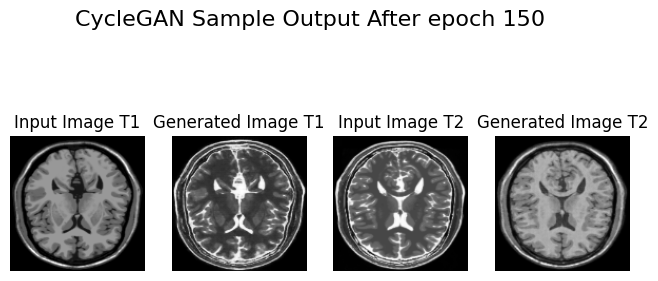

421/421 [==============================] - 64s 153ms/step - G_loss: 6.1780 - F_loss: 5.1330 - D_X_loss: 0.1649 - D_Y_loss: 0.1298 - Total_Generator_Loss: 11.3110


In [ ]:
# Fit the model
history = cycle_gan_model.fit(
    tf.data.Dataset.zip((train_t1_images, train_t2_images)),
    epochs=epochs,
    callbacks=[plotter],
)

In [ ]:
# Specify the path in Google Drive
save_path = '/content/drive/MyDrive/MRI Dataset/CycleGAN_Checkpoints/my_cycle_gan_model'

In [ ]:
# Dummy run to build the model
dummy_input = tf.random.normal([1, 128,128,1])  # Replace with actual input shape
_ = cycle_gan_model(dummy_input)

# Now try saving the model
cycle_gan_model.save(save_path)


In [ ]:
# Save the entire model
cycle_gan_model.save(save_path)

ValueError: ignored

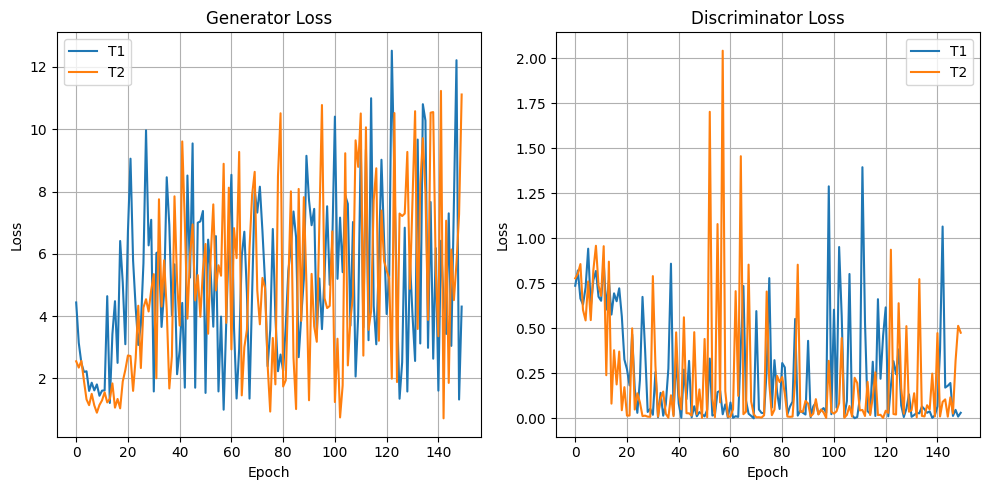

In [ ]:
def plot_hist(hist):
    plt.figure(figsize=(10, 5))
    plt.subplot(121)
    plt.plot(hist.history["G_loss"])
    plt.plot(hist.history["F_loss"])
    plt.legend(["T1", "T2"])
    plt.title("Generator Loss")
    plt.ylabel("Loss")
    plt.xlabel("Epoch")
    plt.grid()
    plt.subplot(122)
    plt.plot(hist.history["D_X_loss"])
    plt.plot(hist.history["D_Y_loss"])
    plt.title("Discriminator Loss")
    plt.ylabel("Loss")
    plt.xlabel("Epoch")
    plt.grid()
    plt.legend(["T1", "T2"])
    plt.tight_layout()
    plt.show()


plot_hist(history)

### Checking the output of the model

In [ ]:
import os
import imageio

# Set the path where your images are stored
pro_img_path = "/content/drive/MyDrive/MRI Dataset/Image Epochs/"

# Get the list of image filenames, sorted by creation time or name
filenames = sorted([os.path.join(pro_img_path, file) for file in os.listdir(pro_img_path)], key=lambda x: os.path.getmtime(x))

img_list = []
for filename in filenames:
    try:
        img = imageio.imread(filename)
        img_list.append(img)
    except Exception as e:
        print(f"Error reading {filename}: {e}")

# Set the name and path for the output GIF file
anim_file = "/content/drive/MyDrive/MRI Dataset/Image Epochs/cyclegan_mri_pre.gif"

# Create the GIF
imageio.mimsave(anim_file, img_list, duration=2, loop=10)

print(f"GIF saved as {anim_file}")

Error reading /content/drive/MyDrive/MRI Dataset/Image Epochs/.ipynb_checkpoints: ImageIO does not generally support reading folders. Limited support may be available via specific plugins. Specify the plugin explicitly using the `plugin` kwarg, e.g. `plugin='DICOM'`


ValueError: ignored

In [ ]:
pip install tensorflow_docs

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.6/183.6 kB 4.3 MB/s eta 0:00:00



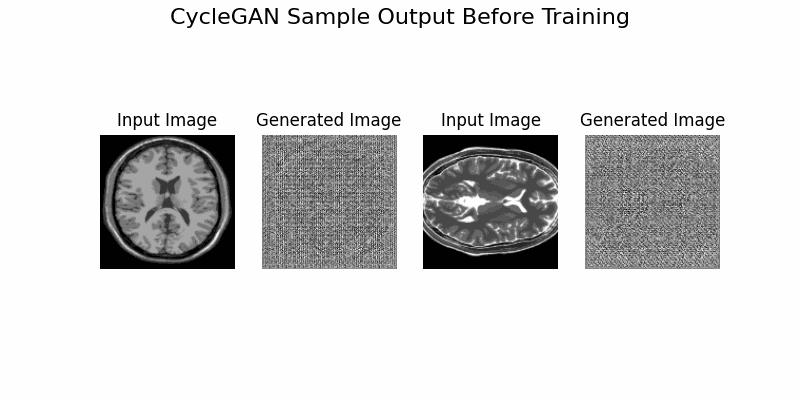

In [ ]:
import tensorflow_docs.vis.embed as embed

embed.embed_file('/content/drive/MyDrive/MRI Dataset/Image Epochs/cyclegan_mri_pre.gif')

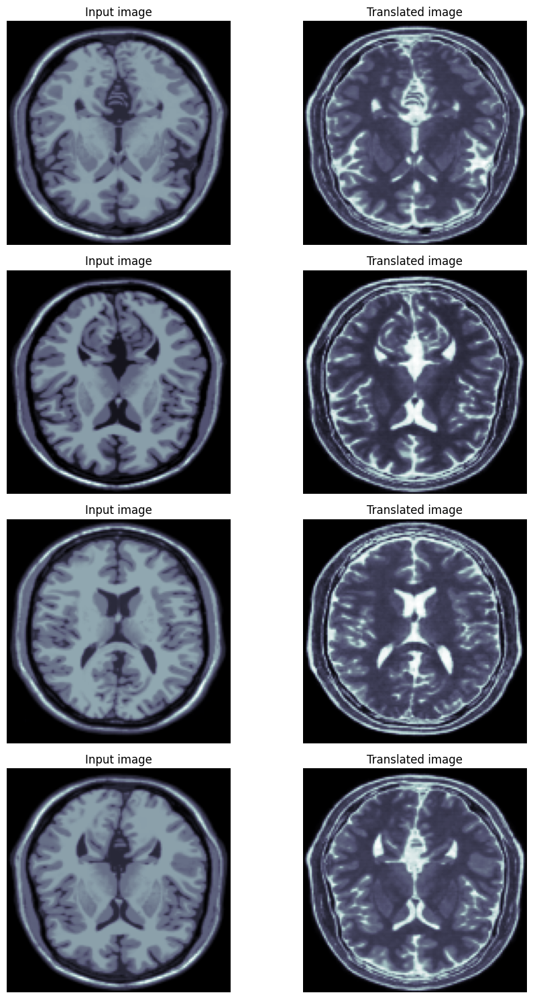

In [ ]:
# evaluate the model for T1 to T2
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(t1_images.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img, cmap="bone")
    ax[i, 1].imshow(prediction, cmap="bone")
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = tf.keras.utils.array_to_img(prediction)
plt.tight_layout()
plt.show()

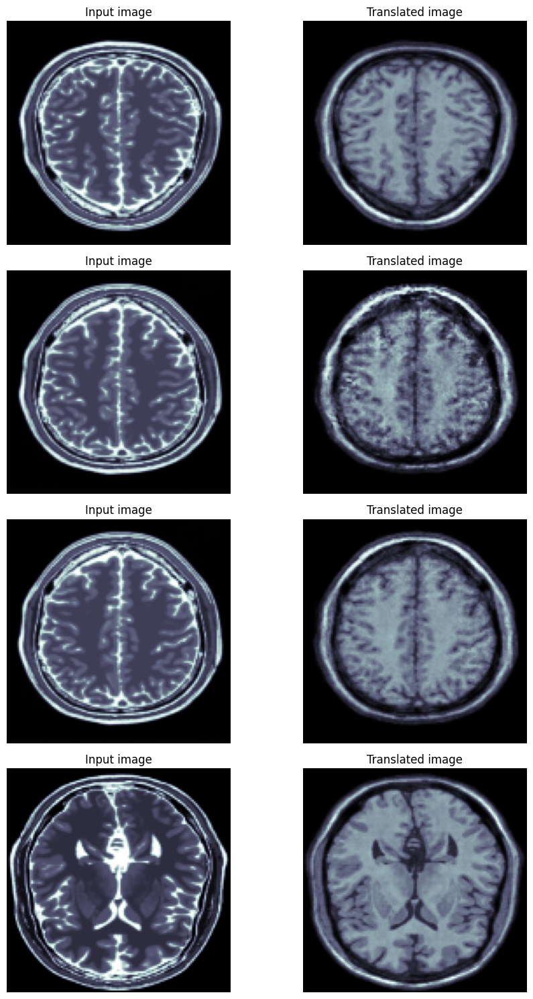

In [ ]:
# evaluate the model for T2 to T1
_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(t2_images.take(4)):
    prediction = cycle_gan_model.gen_F(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img, cmap="bone")
    ax[i, 1].imshow(prediction, cmap="bone")
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = tf.keras.utils.array_to_img(prediction)
plt.tight_layout()
plt.show()

In [ ]:
from tensorflow.keras.models import load_model
import tensorflow_addons as tfa
import tensorflow as tf

# Assuming you have custom layers or functions, define them here
# For example, if you had a custom layer 'CustomLayer', you would define it as follows:
# class CustomLayer(tf.keras.layers.Layer):
#     ...

# Load the model (replace with your model's path)
loaded_cycle_gan_model = load_model('/content/drive/MyDrive/MRI Dataset/CycleGAN_Checkpoints/my_cycle_gan_model', custom_objects={
    'InstanceNormalization': tfa.layers.InstanceNormalization
    # Include other custom objects here if you have any
})

# Now, you can use loaded_cycle_gan_model for making predictions on your test data
# For example:
# test_data = ...  # Load or prepare your test data here
# predictions = loaded_cycle_gan_model.predict(test_data)

# Then, you can evaluate the predictions as per your requirements


In [ ]:
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from skimage.metrics import structural_similarity as compare_ssim

# Function to calculate PSNR and SSIM for a batch of images
def calculate_metrics(generator, test_dataset, num_samples=3):
    psnr_values = []
    ssim_values = []

    for img in test_dataset.take(num_samples):
        # Reshape the image to remove the batch dimension
        # img is a batch of one image, so we take the first (and only) image in the batch
        img = img[0]  # img is now of shape (1, height, width, channels)
        ground_truth = img.numpy()[0]  # Remove the batch dimension

        # Generate the image
        generated_image = generator_f(img, training=False)
        generated_image = generated_image[0].numpy()  # Remove the batch dimension

        # Flatten the images if they have extra dimensions
        ground_truth = np.squeeze(ground_truth)
        generated_image = np.squeeze(generated_image)

        # Ensure the images are 2D arrays if they are grayscale
        if ground_truth.ndim == 3:
            ground_truth = ground_truth[..., 0]
        if generated_image.ndim == 3:
            generated_image = generated_image[..., 0]

        # Calculate PSNR and SSIM
        psnr = compare_psnr(ground_truth, generated_image, data_range=ground_truth.max() - ground_truth.min())
        ssim = compare_ssim(ground_truth, generated_image, data_range=ground_truth.max() - ground_truth.min())

        psnr_values.append(psnr)
        ssim_values.append(ssim)

    avg_psnr = np.mean(psnr_values)
    avg_ssim = np.mean(ssim_values)

    print(f'Average PSNR over {num_samples} samples: {avg_psnr:.2f}')
    print(f'Average SSIM over {num_samples} samples: {avg_ssim:.2f}')

    return avg_psnr, avg_ssim

# Prepare the test datasets
t1_test_batched = test_t1_images.batch(1)

# Calculate metrics for T1 to T2 translation
print("Calculating metrics for T1 to T2 translation...")
avg_psnr_t1_to_t2, avg_ssim_t1_to_t2 = calculate_metrics(generator_g, t1_test_batched, num_samples=100)

Calculating metrics for T1 to T2 translation...
Average PSNR over 100 samples: 8.09
Average SSIM over 100 samples: 0.00


In [ ]:
from skimage.metrics import peak_signal_noise_ratio as compare_psnr
from skimage.metrics import structural_similarity as compare_ssim

# Function to calculate PSNR and SSIM for a batch of images
def calculate_metrics(generator, test_dataset, num_samples=3):
    psnr_values = []
    ssim_values = []

    for img in test_dataset.take(num_samples):
        # Reshape the image to remove the batch dimension
        # img is a batch of one image, so we take the first (and only) image in the batch
        img = img[0]  # img is now of shape (1, height, width, channels)
        ground_truth = img.numpy()[0]  # Remove the batch dimension

        # Generate the image
        generated_image = generator_g(img, training=False)
        generated_image = generated_image[0].numpy()  # Remove the batch dimension

        # Flatten the images if they have extra dimensions
        ground_truth = np.squeeze(ground_truth)
        generated_image = np.squeeze(generated_image)

        # Ensure the images are 2D arrays if they are grayscale
        if ground_truth.ndim == 3:
            ground_truth = ground_truth[..., 0]
        if generated_image.ndim == 3:
            generated_image = generated_image[..., 0]

        # Calculate PSNR and SSIM
        psnr = compare_psnr(ground_truth, generated_image, data_range=ground_truth.max() - ground_truth.min())
        ssim = compare_ssim(ground_truth, generated_image, data_range=ground_truth.max() - ground_truth.min())

        psnr_values.append(psnr)
        ssim_values.append(ssim)

    avg_psnr = np.mean(psnr_values)
    avg_ssim = np.mean(ssim_values)

    print(f'Average PSNR over {num_samples} samples: {avg_psnr:.2f}')
    print(f'Average SSIM over {num_samples} samples: {avg_ssim:.2f}')

    return avg_psnr, avg_ssim

# Prepare the test datasets
t2_test_batched = test_t2_images.batch(1)

# Calculate metrics for T2 to T1 translation
print("\nCalculating metrics for T2 to T1 translation...")
avg_psnr_t2_to_t1, avg_ssim_t2_to_t1 = calculate_metrics(generator_f, t2_test_batched, num_samples=100)


Calculating metrics for T2 to T1 translation...
Average PSNR over 100 samples: 7.73
Average SSIM over 100 samples: -0.00
